In [1]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

In [2]:
df = pd.read_csv("../data/processed.csv")

In [3]:
df.isnull().sum()

person_age                     0
person_income                  0
person_home_ownership          0
person_emp_length              0
loan_intent                    0
loan_amnt                      0
loan_int_rate                  0
loan_status                    0
loan_percent_income            0
cb_person_default_on_file      0
cb_person_cred_hist_length     0
age_group                      0
loan_amnt_group                0
income_group                   0
loan_to_income                 0
loan_to_emp_length_ratio       0
int_rate_to loan_amnt_ratio    0
dtype: int64

In [4]:
df.duplicated().sum()

0

## 1. Data processing

In [5]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, StandardScaler


In [6]:

X = df.drop(columns=['loan_status']) 
Y = df['loan_status']

x_train, x_temp, y_train, y_temp = train_test_split(X, Y, test_size=0.3, random_state=12)
x_val, x_test, y_val, y_test = train_test_split(x_temp, y_temp, test_size=0.5, random_state=12)

In [7]:
numeric_cols = [
    'person_age', 'person_income', 'person_emp_length', 
    'loan_amnt', 'loan_int_rate', 'loan_percent_income', 
    'cb_person_cred_hist_length', 'loan_to_income', 
    'loan_to_emp_length_ratio', 'int_rate_to loan_amnt_ratio'
]

ohe_cols = [
    'person_home_ownership', 'loan_intent', 
    'cb_person_default_on_file', 'age_group', 
    'loan_amnt_group', 'income_group'
]

In [8]:
ohe = OneHotEncoder(sparse_output=False, handle_unknown='ignore')
ohe.fit(x_train[ohe_cols])

x_train_ohe = pd.DataFrame(ohe.transform(x_train[ohe_cols]), columns=ohe.get_feature_names_out(ohe_cols))
x_val_ohe = pd.DataFrame(ohe.transform(x_val[ohe_cols]), columns=ohe.get_feature_names_out(ohe_cols))
x_test_ohe = pd.DataFrame(ohe.transform(x_test[ohe_cols]), columns=ohe.get_feature_names_out(ohe_cols))
x_train_ohe.reset_index(drop=True, inplace=True)
x_val_ohe.reset_index(drop=True, inplace=True)
x_test_ohe.reset_index(drop=True, inplace=True)
x_train.reset_index(drop=True, inplace=True)
x_val.reset_index(drop=True, inplace=True)
x_test.reset_index(drop=True, inplace=True)
x_train = x_train.drop(columns=ohe_cols)
x_val = x_val.drop(columns=ohe_cols)
x_test = x_test.drop(columns=ohe_cols)
x_train = pd.concat([x_train, x_train_ohe], axis=1)
x_val = pd.concat([x_val, x_val_ohe], axis=1)
x_test = pd.concat([x_test, x_test_ohe], axis=1)

scaler = StandardScaler()
scaler.fit(x_train[numeric_cols])

x_train_scaled = pd.DataFrame(scaler.transform(x_train[numeric_cols]), columns=numeric_cols)
x_val_scaled = pd.DataFrame(scaler.transform(x_val[numeric_cols]), columns=numeric_cols)
x_test_scaled = pd.DataFrame(scaler.transform(x_test[numeric_cols]), columns=numeric_cols)

x_train_scaled.reset_index(drop=True, inplace=True)
x_val_scaled.reset_index(drop=True, inplace=True)
x_test_scaled.reset_index(drop=True, inplace=True)

x_train = x_train.drop(columns=numeric_cols)
x_val = x_val.drop(columns=numeric_cols)
x_test = x_test.drop(columns=numeric_cols)

x_train = pd.concat([x_train, x_train_scaled], axis=1)
x_val = pd.concat([x_val, x_val_scaled], axis=1)
x_test = pd.concat([x_test, x_test_scaled], axis=1)

print(f"x_train shape: {x_train.shape}")
print(f"x_val shape: {x_val.shape}")
print(f"x_test shape: {x_test.shape}")


x_train shape: (22679, 36)
x_val shape: (4860, 36)
x_test shape: (4860, 36)


## 2. Modelisation & Evaluation

In [9]:
import mlflow
from scipy.stats import randint, uniform
import mlflow.sklearn
from lightgbm import LGBMClassifier
from sklearn.ensemble import GradientBoostingClassifier, RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score, f1_score, recall_score, confusion_matrix, classification_report



In [10]:
scale_pos_weight = ((y_train == 0).sum() / (y_train == 1).sum()) * 1.2


In [11]:
models = {
    "GradientBoosting": GradientBoostingClassifier(random_state=42),
    "RandomForest": RandomForestClassifier(random_state=42),
    "LogisticRegression": LogisticRegression(max_iter=1000, random_state=42),
    "LightGBM": LGBMClassifier(random_state=42, scale_pos_weight= scale_pos_weight),
}


In [12]:
mlflow.set_tracking_uri("file:///media/Data/Repositories/credit_risk_prediction/mlruns")
mlflow.set_experiment("Binary")

<Experiment: artifact_location='file:///media/Data/Repositories/credit_risk_prediction/mlruns/907417149689263115', creation_time=1739026105253, experiment_id='907417149689263115', last_update_time=1739026105253, lifecycle_stage='active', name='Binary', tags={}>

In [13]:
def evaluate_model(model, x_train, y_train, x_test, y_test, threshold=0.42):
    """Binary
    Entraîne le modèle, applique le seuil de classification et calcule les métriques.
    """
    model.fit(x_train, y_train)
    # Probabilités prédites pour la classe 1
    probabilities = model.predict_proba(x_test)[:, 1]
    # Application du seuil personnalisé
    predictions = (probabilities >= threshold).astype(int)
    
    auc_score = roc_auc_score(y_test, probabilities)
    f1 = f1_score(y_test, predictions)
    recall = recall_score(y_test, predictions)
    conf_matrix = confusion_matrix(y_test, predictions)
    class_report = classification_report(y_test, predictions)
    
    return auc_score, conf_matrix, class_report, f1, recall


for model_name, model in models.items():
    with mlflow.start_run(run_name=model_name):
        auc, conf_matrix, class_report, f1, recall = evaluate_model(model, x_train, y_train, x_val, y_val)
        
        mlflow.log_param("model_name", model_name)
        mlflow.log_metric("auc", auc)
        mlflow.log_metric("f1", f1)
        mlflow.log_metric("recall", recall)
        mlflow.log_text(str(conf_matrix), "confusion_matrix.txt")
        mlflow.log_text(class_report, "classification_report.txt")
        mlflow.sklearn.log_model(model, artifact_path="model")


2025/02/11 03:59:13 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.
2025/02/11 03:59:47 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.
2025/02/11 03:59:57 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002970 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623


2025/02/11 04:00:04 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001414 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000
[LightGBM] [Info] Start training from score -0.000000


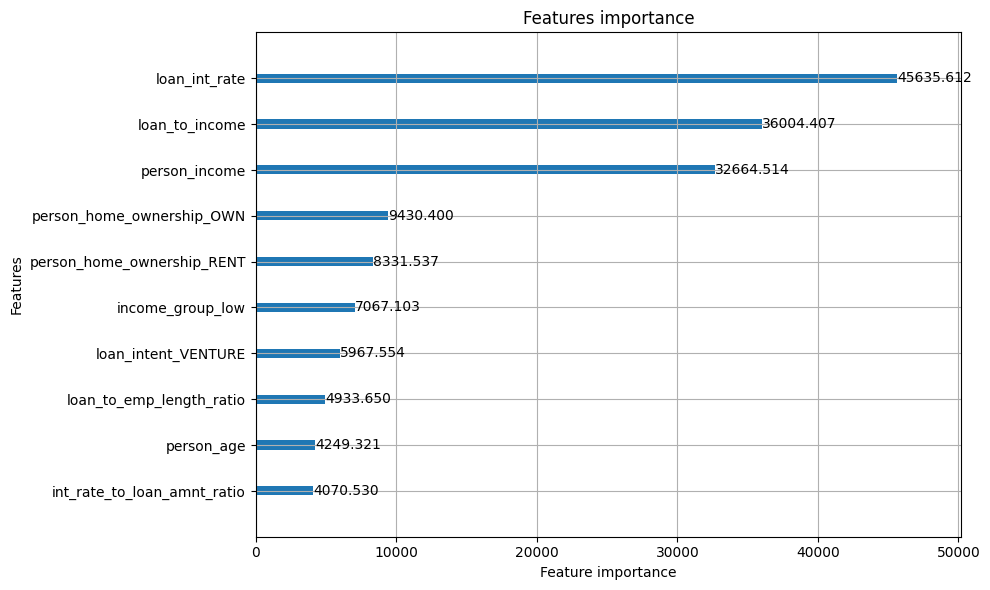

In [14]:
import lightgbm as lgb
import matplotlib.pyplot as plt

model = LGBMClassifier(random_state=42, scale_pos_weight= scale_pos_weight, class_weight="balanced")
model.fit(x_train, y_train)
ax = lgb.plot_importance(model, 
                          max_num_features=10,        
                          importance_type='gain',    
                          figsize=(10, 6))
plt.title("Features importance")
plt.tight_layout()
plt.show()


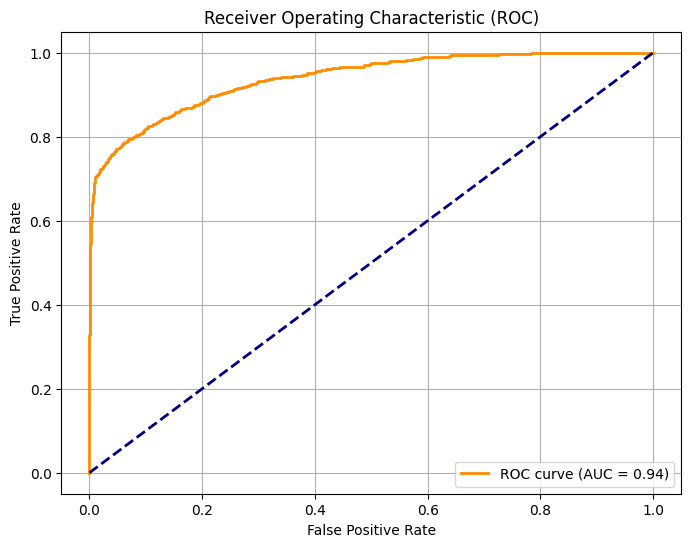

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

def plot_roc_curve(model, x_val, y_val):
    """
    Trace la courbe ROC pour un modèle de classification binaire.
    Parameters:
        model: Le modèle entraîné qui doit supporter la méthode predict_proba.
        x_val: Les données de validation (features).
        y_val: Les vraies étiquettes (labels) de validation.
    """
    y_prob = model.predict_proba(x_val)[:, 1]    
    fpr, tpr, thresholds = roc_curve(y_val, y_prob)
    roc_auc = auc(fpr, tpr)
    
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f"ROC curve (AUC = {roc_auc:.2f})")
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')  
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("Receiver Operating Characteristic (ROC)")
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()

plot_roc_curve(model, x_val, y_val)


*`Conclusion`* : LightGBM est le plus efficient 

## 3. Tuning

In [16]:
import optuna
import lightgbm as lgb
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import recall_score, precision_recall_curve, f1_score, roc_auc_score
import numpy as np


In [17]:
scale_pos_weight = len(y_train) / (2.0 * sum(y_train))


In [18]:
import optuna
from sklearn.model_selection import train_test_split
import lightgbm as lgb
from sklearn.metrics import roc_auc_score, f1_score, recall_score

def objective(trial):
    # Paramètres du modèle LightGBM à tester
    param = {
        'objective': 'binary',
        'metric': 'auc',
        'boosting_type': 'gbdt',
        'max_depth': trial.suggest_int('max_depth', 3, 12),
        'num_leaves': trial.suggest_int('num_leaves', 20, 100),
        'n_estimators': trial.suggest_int('n_estimators', 50, 1000),
        'scale_pos_weight': trial.suggest_float('scale_pos_weight', 1.0, 10.0),  # Handle class imbalance
        'learning_rate': trial.suggest_float('learning_rate', 1e-5, 1e-1, log=True),
        'subsample': trial.suggest_float('subsample', 0.7, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.7, 1.0),
        'min_child_samples': trial.suggest_int('min_child_samples', 10, 100)  # Avoid overfitting
    }

    # Entraînement du modèle avec les paramètres
    model = lgb.LGBMClassifier(**param)
    model.fit(x_train, y_train, eval_set=[(x_val, y_val)])

    # Prédictions pour calculer le score
    y_pred_prob = model.predict_proba(x_val)[:, 1]
    
    # Adjusting the threshold to prioritize recall
    threshold = 0.3  # Lower threshold to favor recall
    y_pred = (y_pred_prob >= threshold).astype(int)
    
    # Calculating the AUC, F1, and Recall scores
    auc = roc_auc_score(y_val, y_pred_prob)
    f1 = f1_score(y_val, y_pred)
    recall = recall_score(y_val, y_pred)

    # You can optimize based on AUC, F1, or recall; here, it's focused on recall
    return recall  # Prioritizing recall for optimization

# Création de l'étude Optuna
study = optuna.create_study(direction='maximize')  # Maximize recall
study.optimize(objective, n_trials=300)

# Meilleurs hyperparamètres trouvés
params = study.best_params
print("Meilleurs paramètres: ", params)

# You can print the final performance metrics
print("Final Recall after optimization:", study.best_value)


[I 2025-02-11 04:00:07,724] A new study created in memory with name: no-name-701d294c-8020-4f12-b4ca-db4c30857ce2


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001162 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1743
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 34
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:00:08,277] Trial 0 finished with value: 0.0 and parameters: {'max_depth': 5, 'num_leaves': 63, 'n_estimators': 269, 'scale_pos_weight': 5.167372556259181, 'learning_rate': 0.0003735355085157286, 'subsample': 0.8375537654800715, 'colsample_bytree': 0.7710133148883997, 'min_child_samples': 93}. Best is trial 0 with value: 0.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:00:09,888] Trial 1 finished with value: 0.0 and parameters: {'max_depth': 11, 'num_leaves': 98, 'n_estimators': 333, 'scale_pos_weight': 6.263160803880395, 'learning_rate': 8.004334589162771e-05, 'subsample': 0.8485691832839495, 'colsample_bytree': 0.7584943342439054, 'min_child_samples': 22}. Best is trial 0 with value: 0.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001450 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1743
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 34
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:00:11,276] Trial 2 finished with value: 0.9104618284637135 and parameters: {'max_depth': 6, 'num_leaves': 81, 'n_estimators': 634, 'scale_pos_weight': 8.291457900913908, 'learning_rate': 0.09741688587692235, 'subsample': 0.9844235171588209, 'colsample_bytree': 0.7735657514869335, 'min_child_samples': 99}. Best is trial 2 with value: 0.9104618284637135.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001563 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1743
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 34
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623


[I 2025-02-11 04:00:13,662] Trial 3 finished with value: 0.0 and parameters: {'max_depth': 10, 'num_leaves': 54, 'n_estimators': 601, 'scale_pos_weight': 8.70920132783272, 'learning_rate': 1.558209339855903e-05, 'subsample': 0.7553157447553219, 'colsample_bytree': 0.8385203454741748, 'min_child_samples': 90}. Best is trial 2 with value: 0.9104618284637135.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001381 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623


[I 2025-02-11 04:00:15,432] Trial 4 finished with value: 0.0 and parameters: {'max_depth': 11, 'num_leaves': 34, 'n_estimators': 548, 'scale_pos_weight': 3.2926716832244387, 'learning_rate': 0.00016354765045181212, 'subsample': 0.7536597364971714, 'colsample_bytree': 0.976135189144997, 'min_child_samples': 65}. Best is trial 2 with value: 0.9104618284637135.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001363 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623


[I 2025-02-11 04:00:18,438] Trial 5 finished with value: 0.8699340245051838 and parameters: {'max_depth': 11, 'num_leaves': 50, 'n_estimators': 806, 'scale_pos_weight': 4.17102883776154, 'learning_rate': 0.0007973373511297089, 'subsample': 0.7389275688379047, 'colsample_bytree': 0.8835418284315738, 'min_child_samples': 14}. Best is trial 2 with value: 0.9104618284637135.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001664 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623


[I 2025-02-11 04:00:20,665] Trial 6 finished with value: 0.8520263901979265 and parameters: {'max_depth': 10, 'num_leaves': 79, 'n_estimators': 516, 'scale_pos_weight': 5.579995298632742, 'learning_rate': 0.0007628874220390727, 'subsample': 0.9233445111170782, 'colsample_bytree': 0.7640997017695483, 'min_child_samples': 39}. Best is trial 2 with value: 0.9104618284637135.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001365 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:00:21,578] Trial 7 finished with value: 0.0 and parameters: {'max_depth': 5, 'num_leaves': 100, 'n_estimators': 402, 'scale_pos_weight': 2.4164614399656306, 'learning_rate': 0.0001911578276159186, 'subsample': 0.7268936671835295, 'colsample_bytree': 0.8016336431009309, 'min_child_samples': 81}. Best is trial 2 with value: 0.9104618284637135.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001366 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:00:23,828] Trial 8 finished with value: 0.9180018850141376 and parameters: {'max_depth': 9, 'num_leaves': 61, 'n_estimators': 680, 'scale_pos_weight': 6.623702971470474, 'learning_rate': 0.026831820913900434, 'subsample': 0.9588663048334459, 'colsample_bytree': 0.9487592804422732, 'min_child_samples': 75}. Best is trial 8 with value: 0.9180018850141376.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001423 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623


[I 2025-02-11 04:00:24,155] Trial 9 finished with value: 0.8180961357210179 and parameters: {'max_depth': 12, 'num_leaves': 23, 'n_estimators': 105, 'scale_pos_weight': 2.078158637939284, 'learning_rate': 0.030097615039141375, 'subsample': 0.7292040754507627, 'colsample_bytree': 0.7710808808022294, 'min_child_samples': 41}. Best is trial 8 with value: 0.9180018850141376.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001334 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:00:27,411] Trial 10 finished with value: 0.9622997172478793 and parameters: {'max_depth': 8, 'num_leaves': 71, 'n_estimators': 974, 'scale_pos_weight': 7.211467121278931, 'learning_rate': 0.006338009713533439, 'subsample': 0.9958744834497388, 'colsample_bytree': 0.9980342488418111, 'min_child_samples': 68}. Best is trial 10 with value: 0.9622997172478793.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001366 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:00:31,061] Trial 11 finished with value: 0.9613572101790764 and parameters: {'max_depth': 8, 'num_leaves': 66, 'n_estimators': 970, 'scale_pos_weight': 7.810839716732735, 'learning_rate': 0.00695698038598647, 'subsample': 0.9978837294709487, 'colsample_bytree': 0.977275292206179, 'min_child_samples': 69}. Best is trial 10 with value: 0.9622997172478793.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001403 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:00:34,174] Trial 12 finished with value: 0.9820923656927427 and parameters: {'max_depth': 7, 'num_leaves': 76, 'n_estimators': 976, 'scale_pos_weight': 9.874466158880693, 'learning_rate': 0.006410878304551465, 'subsample': 0.9353079586370677, 'colsample_bytree': 0.9205052595125447, 'min_child_samples': 58}. Best is trial 12 with value: 0.9820923656927427.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001429 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:00:37,549] Trial 13 finished with value: 0.9858623939679547 and parameters: {'max_depth': 7, 'num_leaves': 80, 'n_estimators': 959, 'scale_pos_weight': 9.93019724017659, 'learning_rate': 0.0038607554581213213, 'subsample': 0.9145387040714166, 'colsample_bytree': 0.9176267364907175, 'min_child_samples': 52}. Best is trial 13 with value: 0.9858623939679547.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001330 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:00:38,829] Trial 14 finished with value: 0.9952874646559849 and parameters: {'max_depth': 3, 'num_leaves': 85, 'n_estimators': 828, 'scale_pos_weight': 9.997373442691654, 'learning_rate': 0.0028504135160708445, 'subsample': 0.8993514872783009, 'colsample_bytree': 0.9044149498690321, 'min_child_samples': 52}. Best is trial 14 with value: 0.9952874646559849.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:00:40,115] Trial 15 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 87, 'n_estimators': 808, 'scale_pos_weight': 9.600480026807778, 'learning_rate': 0.0028734824003956495, 'subsample': 0.8874954120565972, 'colsample_bytree': 0.7094412049045387, 'min_child_samples': 43}. Best is trial 15 with value: 0.9990574929311969.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:00:41,342] Trial 16 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 90, 'n_estimators': 799, 'scale_pos_weight': 8.610196380428388, 'learning_rate': 0.0020940560414671426, 'subsample': 0.8795261327063723, 'colsample_bytree': 0.7064858129857178, 'min_child_samples': 36}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:00:42,494] Trial 17 finished with value: 0.9971724787935909 and parameters: {'max_depth': 3, 'num_leaves': 92, 'n_estimators': 779, 'scale_pos_weight': 8.438876421309214, 'learning_rate': 0.0018486244679579863, 'subsample': 0.8836661975546064, 'colsample_bytree': 0.702777608561466, 'min_child_samples': 34}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001423 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:00:44,280] Trial 18 finished with value: 0.0 and parameters: {'max_depth': 4, 'num_leaves': 90, 'n_estimators': 855, 'scale_pos_weight': 8.921385503439565, 'learning_rate': 4.376984686795877e-05, 'subsample': 0.802465182590467, 'colsample_bytree': 0.705351413324572, 'min_child_samples': 29}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001260 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:00:45,552] Trial 19 finished with value: 0.9773798303487277 and parameters: {'max_depth': 4, 'num_leaves': 90, 'n_estimators': 721, 'scale_pos_weight': 7.381704507172474, 'learning_rate': 0.017415423515939915, 'subsample': 0.8744856583270224, 'colsample_bytree': 0.7281331386811597, 'min_child_samples': 45}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:00:46,770] Trial 20 finished with value: 0.9707822808671065 and parameters: {'max_depth': 4, 'num_leaves': 71, 'n_estimators': 502, 'scale_pos_weight': 9.10266117437706, 'learning_rate': 0.001365793769058701, 'subsample': 0.7950649245691914, 'colsample_bytree': 0.821316687402047, 'min_child_samples': 24}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Foun

[I 2025-02-11 04:00:48,213] Trial 21 finished with value: 0.9934024505183789 and parameters: {'max_depth': 3, 'num_leaves': 92, 'n_estimators': 749, 'scale_pos_weight': 8.13709994752579, 'learning_rate': 0.0016771527372793683, 'subsample': 0.8828003641143015, 'colsample_bytree': 0.7022635108872187, 'min_child_samples': 32}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Nu

[I 2025-02-11 04:00:50,295] Trial 22 finished with value: 0.8671065032987747 and parameters: {'max_depth': 3, 'num_leaves': 94, 'n_estimators': 865, 'scale_pos_weight': 9.11010870341908, 'learning_rate': 0.00039466038252488445, 'subsample': 0.8665555310396523, 'colsample_bytree': 0.7338741596911007, 'min_child_samples': 10}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001638 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:00:52,290] Trial 23 finished with value: 0.9792648444863337 and parameters: {'max_depth': 5, 'num_leaves': 86, 'n_estimators': 754, 'scale_pos_weight': 7.063791600331443, 'learning_rate': 0.0022443168768983353, 'subsample': 0.8206073032012913, 'colsample_bytree': 0.7317097248436896, 'min_child_samples': 34}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001485 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:00:53,772] Trial 24 finished with value: 0.9858623939679547 and parameters: {'max_depth': 3, 'num_leaves': 47, 'n_estimators': 900, 'scale_pos_weight': 9.28583167174967, 'learning_rate': 0.012632075910025556, 'subsample': 0.9432713967857562, 'colsample_bytree': 0.7042267111110099, 'min_child_samples': 46}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:00:55,347] Trial 25 finished with value: 0.8586239396795476 and parameters: {'max_depth': 4, 'num_leaves': 98, 'n_estimators': 662, 'scale_pos_weight': 8.169530484274294, 'learning_rate': 0.0005235498912343864, 'subsample': 0.9005612229506773, 'colsample_bytree': 0.7955607965398135, 'min_child_samples': 22}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:00:57,967] Trial 26 finished with value: 0.9538171536286523 and parameters: {'max_depth': 6, 'num_leaves': 73, 'n_estimators': 780, 'scale_pos_weight': 6.0155893956335, 'learning_rate': 0.0014294442747299948, 'subsample': 0.8614132497394794, 'colsample_bytree': 0.7444837153767949, 'min_child_samples': 58}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001482 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:01:00,766] Trial 27 finished with value: 0.9830348727615457 and parameters: {'max_depth': 6, 'num_leaves': 86, 'n_estimators': 888, 'scale_pos_weight': 8.45544670540154, 'learning_rate': 0.003549229164340754, 'subsample': 0.8270277178574903, 'colsample_bytree': 0.7196652894326339, 'min_child_samples': 39}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001983 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:01:02,132] Trial 28 finished with value: 0.7879359095193214 and parameters: {'max_depth': 3, 'num_leaves': 85, 'n_estimators': 717, 'scale_pos_weight': 1.0312876134107896, 'learning_rate': 0.08058854196077585, 'subsample': 0.8977123936480809, 'colsample_bytree': 0.8656078688772082, 'min_child_samples': 27}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001653 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:01:04,174] Trial 29 finished with value: 0.0 and parameters: {'max_depth': 5, 'num_leaves': 66, 'n_estimators': 444, 'scale_pos_weight': 5.066055255243352, 'learning_rate': 0.0001497551960475575, 'subsample': 0.8533802756265124, 'colsample_bytree': 0.754037260119611, 'min_child_samples': 47}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001529 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:01:04,628] Trial 30 finished with value: 0.0 and parameters: {'max_depth': 4, 'num_leaves': 94, 'n_estimators': 125, 'scale_pos_weight': 7.6397874684051335, 'learning_rate': 0.00030558751920340365, 'subsample': 0.9581619999136245, 'colsample_bytree': 0.7927548963611813, 'min_child_samples': 15}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:01:06,543] Trial 31 finished with value: 0.9952874646559849 and parameters: {'max_depth': 3, 'num_leaves': 84, 'n_estimators': 829, 'scale_pos_weight': 9.640647177437323, 'learning_rate': 0.0035390009824577255, 'subsample': 0.8946724065443247, 'colsample_bytree': 0.90649084655178, 'min_child_samples': 51}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001851 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:01:08,382] Trial 32 finished with value: 0.9952874646559849 and parameters: {'max_depth': 3, 'num_leaves': 94, 'n_estimators': 803, 'scale_pos_weight': 9.450282455521378, 'learning_rate': 0.0028717921360107103, 'subsample': 0.8421857816495599, 'colsample_bytree': 0.8898303737284246, 'min_child_samples': 36}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001549 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:01:11,331] Trial 33 finished with value: 0.9670122525918945 and parameters: {'max_depth': 5, 'num_leaves': 100, 'n_estimators': 601, 'scale_pos_weight': 8.55061734975175, 'learning_rate': 0.0009918852029585923, 'subsample': 0.9122287960751716, 'colsample_bytree': 0.7190144551212445, 'min_child_samples': 61}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004901 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with pos

[I 2025-02-11 04:01:14,412] Trial 34 finished with value: 0.9858623939679547 and parameters: {'max_depth': 4, 'num_leaves': 76, 'n_estimators': 920, 'scale_pos_weight': 9.857835639827147, 'learning_rate': 0.010400524046747649, 'subsample': 0.881588040649787, 'colsample_bytree': 0.8439322629506608, 'min_child_samples': 52}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001730 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:01:15,787] Trial 35 finished with value: 0.9915174363807728 and parameters: {'max_depth': 3, 'num_leaves': 88, 'n_estimators': 616, 'scale_pos_weight': 8.84321402417459, 'learning_rate': 0.002109780865354922, 'subsample': 0.7006439204029264, 'colsample_bytree': 0.943742162629333, 'min_child_samples': 40}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:01:18,354] Trial 36 finished with value: 0.9868049010367578 and parameters: {'max_depth': 4, 'num_leaves': 82, 'n_estimators': 700, 'scale_pos_weight': 7.948447612008334, 'learning_rate': 0.005075043121247462, 'subsample': 0.9275196827409828, 'colsample_bytree': 0.7440980609348474, 'min_child_samples': 31}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-ch

[I 2025-02-11 04:01:19,418] Trial 37 finished with value: 0.43355325164938735 and parameters: {'max_depth': 5, 'num_leaves': 43, 'n_estimators': 204, 'scale_pos_weight': 6.484193634319883, 'learning_rate': 0.0006089397794100901, 'subsample': 0.8416155788777231, 'colsample_bytree': 0.8235994301549565, 'min_child_samples': 21}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:01:21,122] Trial 38 finished with value: 0.0 and parameters: {'max_depth': 3, 'num_leaves': 95, 'n_estimators': 570, 'scale_pos_weight': 4.4997742775716905, 'learning_rate': 1.0537371680004808e-05, 'subsample': 0.9498708057569419, 'colsample_bytree': 0.7806035974545298, 'min_child_samples': 44}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.055389 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:01:24,569] Trial 39 finished with value: 0.9886899151743638 and parameters: {'max_depth': 4, 'num_leaves': 54, 'n_estimators': 822, 'scale_pos_weight': 9.386503623546504, 'learning_rate': 0.0011672113145081897, 'subsample': 0.9072603912251337, 'colsample_bytree': 0.8626540274416886, 'min_child_samples': 36}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010299 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1743
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 34
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with pos

[I 2025-02-11 04:01:27,921] Trial 40 finished with value: 0.0 and parameters: {'max_depth': 5, 'num_leaves': 78, 'n_estimators': 653, 'scale_pos_weight': 8.601535599004384, 'learning_rate': 6.499434212511827e-05, 'subsample': 0.9779421874451381, 'colsample_bytree': 0.7589235577594217, 'min_child_samples': 87}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001940 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:01:30,890] Trial 41 finished with value: 0.9971724787935909 and parameters: {'max_depth': 3, 'num_leaves': 83, 'n_estimators': 830, 'scale_pos_weight': 9.70716669561458, 'learning_rate': 0.002521890581269542, 'subsample': 0.9009436060715065, 'colsample_bytree': 0.8975251686574256, 'min_child_samples': 51}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001782 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:01:33,111] Trial 42 finished with value: 0.9934024505183789 and parameters: {'max_depth': 3, 'num_leaves': 82, 'n_estimators': 771, 'scale_pos_weight': 9.414185982888288, 'learning_rate': 0.002195357321869572, 'subsample': 0.890685850623462, 'colsample_bytree': 0.8822427822746381, 'min_child_samples': 56}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007635 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in featur

[I 2025-02-11 04:01:35,086] Trial 43 finished with value: 0.9886899151743638 and parameters: {'max_depth': 3, 'num_leaves': 89, 'n_estimators': 929, 'scale_pos_weight': 9.977614380401574, 'learning_rate': 0.009400999530324116, 'subsample': 0.8713159723263292, 'colsample_bytree': 0.9447505951062114, 'min_child_samples': 49}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Foun

[I 2025-02-11 04:01:38,025] Trial 44 finished with value: 0.9707822808671065 and parameters: {'max_depth': 6, 'num_leaves': 97, 'n_estimators': 847, 'scale_pos_weight': 8.833331454466544, 'learning_rate': 0.000844784147989599, 'subsample': 0.9241789508698345, 'colsample_bytree': 0.8954058782442517, 'min_child_samples': 64}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015038 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with pos

[I 2025-02-11 04:01:40,238] Trial 45 finished with value: 0.9811498586239397 and parameters: {'max_depth': 4, 'num_leaves': 91, 'n_estimators': 800, 'scale_pos_weight': 6.975581073794562, 'learning_rate': 0.004461017179670251, 'subsample': 0.858247935720034, 'colsample_bytree': 0.931028597683066, 'min_child_samples': 41}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001835 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623


[I 2025-02-11 04:01:42,316] Trial 46 finished with value: 0.9764373232799246 and parameters: {'max_depth': 10, 'num_leaves': 75, 'n_estimators': 296, 'scale_pos_weight': 9.599783082303164, 'learning_rate': 0.0028682266405472474, 'subsample': 0.885415229417809, 'colsample_bytree': 0.7160542938994174, 'min_child_samples': 54}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001852 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:01:43,727] Trial 47 finished with value: 0.9811498586239397 and parameters: {'max_depth': 3, 'num_leaves': 25, 'n_estimators': 878, 'scale_pos_weight': 8.420900640122362, 'learning_rate': 0.021670404229029484, 'subsample': 0.9121576175618511, 'colsample_bytree': 0.8729648504845645, 'min_child_samples': 37}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001434 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:01:48,381] Trial 48 finished with value: 0.9585296889726673 and parameters: {'max_depth': 9, 'num_leaves': 69, 'n_estimators': 937, 'scale_pos_weight': 7.77114060449857, 'learning_rate': 0.006888621090999271, 'subsample': 0.9334344442613671, 'colsample_bytree': 0.9691764297578143, 'min_child_samples': 43}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001401 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:01:50,168] Trial 49 finished with value: 0.9905749293119699 and parameters: {'max_depth': 4, 'num_leaves': 80, 'n_estimators': 995, 'scale_pos_weight': 9.00151250670326, 'learning_rate': 0.001869599417014499, 'subsample': 0.8276324078137811, 'colsample_bytree': 0.9074972502304745, 'min_child_samples': 73}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001588 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:01:51,567] Trial 50 finished with value: 0.8303487276154571 and parameters: {'max_depth': 3, 'num_leaves': 57, 'n_estimators': 736, 'scale_pos_weight': 9.970542644028454, 'learning_rate': 0.00027411160500907046, 'subsample': 0.8088290418755382, 'colsample_bytree': 0.8175610280371762, 'min_child_samples': 62}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:01:52,961] Trial 51 finished with value: 0.9952874646559849 and parameters: {'max_depth': 3, 'num_leaves': 85, 'n_estimators': 826, 'scale_pos_weight': 9.541038401756177, 'learning_rate': 0.003566868663030888, 'subsample': 0.8954852283228385, 'colsample_bytree': 0.9036320997289329, 'min_child_samples': 50}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001513 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:01:54,261] Trial 52 finished with value: 0.9952874646559849 and parameters: {'max_depth': 3, 'num_leaves': 85, 'n_estimators': 680, 'scale_pos_weight': 9.640613301307063, 'learning_rate': 0.005228814998993124, 'subsample': 0.8714276680243236, 'colsample_bytree': 0.9165060692624266, 'min_child_samples': 48}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:01:55,886] Trial 53 finished with value: 0.9896324222431668 and parameters: {'max_depth': 4, 'num_leaves': 81, 'n_estimators': 849, 'scale_pos_weight': 9.155715302597734, 'learning_rate': 0.0012906199876576059, 'subsample': 0.8782618101638908, 'colsample_bytree': 0.9277755991363076, 'min_child_samples': 53}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001432 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:01:57,765] Trial 54 finished with value: 0.9886899151743638 and parameters: {'max_depth': 4, 'num_leaves': 88, 'n_estimators': 760, 'scale_pos_weight': 8.231937712298022, 'learning_rate': 0.0027993643786540915, 'subsample': 0.8983826274660124, 'colsample_bytree': 0.7132554164241912, 'min_child_samples': 28}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001388 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:01:59,197] Trial 55 finished with value: 0.9726672950047125 and parameters: {'max_depth': 3, 'num_leaves': 83, 'n_estimators': 908, 'scale_pos_weight': 8.743793621776069, 'learning_rate': 0.0007103937874610696, 'subsample': 0.9177811713506694, 'colsample_bytree': 0.7010067922524124, 'min_child_samples': 57}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:02:00,521] Trial 56 finished with value: 0.9915174363807728 and parameters: {'max_depth': 3, 'num_leaves': 92, 'n_estimators': 793, 'scale_pos_weight': 9.702259569663118, 'learning_rate': 0.008293975636030187, 'subsample': 0.8505286610989129, 'colsample_bytree': 0.8517084654012999, 'min_child_samples': 68}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001473 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623


[I 2025-02-11 04:02:04,770] Trial 57 finished with value: 0.9688972667295005 and parameters: {'max_depth': 12, 'num_leaves': 78, 'n_estimators': 833, 'scale_pos_weight': 9.143175873469756, 'learning_rate': 0.001720434559743113, 'subsample': 0.8889393205013263, 'colsample_bytree': 0.9673542646876659, 'min_child_samples': 34}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001477 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:02:06,678] Trial 58 finished with value: 0.9811498586239397 and parameters: {'max_depth': 4, 'num_leaves': 98, 'n_estimators': 885, 'scale_pos_weight': 7.422161610493657, 'learning_rate': 0.004185263762855044, 'subsample': 0.8659549881196406, 'colsample_bytree': 0.7372856355064316, 'min_child_samples': 44}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001915 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:02:08,423] Trial 59 finished with value: 0.9019792648444863 and parameters: {'max_depth': 5, 'num_leaves': 63, 'n_estimators': 711, 'scale_pos_weight': 3.272126773938659, 'learning_rate': 0.013771747589349029, 'subsample': 0.787245429287554, 'colsample_bytree': 0.8778387824287913, 'min_child_samples': 60}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001730 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:02:11,711] Trial 60 finished with value: 0.94062205466541 and parameters: {'max_depth': 7, 'num_leaves': 88, 'n_estimators': 754, 'scale_pos_weight': 9.274937267872192, 'learning_rate': 0.0005087695290804172, 'subsample': 0.9061664088372626, 'colsample_bytree': 0.7290455024795394, 'min_child_samples': 50}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001420 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1743
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 34
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:02:13,347] Trial 61 finished with value: 0.9952874646559849 and parameters: {'max_depth': 3, 'num_leaves': 94, 'n_estimators': 802, 'scale_pos_weight': 9.513441673666849, 'learning_rate': 0.0032444547055933103, 'subsample': 0.8404595861157002, 'colsample_bytree': 0.8925889828329776, 'min_child_samples': 98}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001592 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:02:15,012] Trial 62 finished with value: 0.9952874646559849 and parameters: {'max_depth': 3, 'num_leaves': 96, 'n_estimators': 946, 'scale_pos_weight': 9.685363975057701, 'learning_rate': 0.0023324740512681748, 'subsample': 0.846920422214721, 'colsample_bytree': 0.8977663477254201, 'min_child_samples': 36}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:02:16,476] Trial 63 finished with value: 0.9802073515551367 and parameters: {'max_depth': 3, 'num_leaves': 92, 'n_estimators': 792, 'scale_pos_weight': 8.781344729665186, 'learning_rate': 0.0011870738490634084, 'subsample': 0.8829723339231547, 'colsample_bytree': 0.9103150864432721, 'min_child_samples': 32}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:02:18,238] Trial 64 finished with value: 0.9896324222431668 and parameters: {'max_depth': 4, 'num_leaves': 87, 'n_estimators': 860, 'scale_pos_weight': 8.116606085893903, 'learning_rate': 0.002736926129573495, 'subsample': 0.862104726067994, 'colsample_bytree': 0.861594763519268, 'min_child_samples': 40}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001667 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:02:19,618] Trial 65 finished with value: 0.9924599434495759 and parameters: {'max_depth': 3, 'num_leaves': 100, 'n_estimators': 825, 'scale_pos_weight': 9.311600687344182, 'learning_rate': 0.005990213296264301, 'subsample': 0.8761783504624691, 'colsample_bytree': 0.8888827350485169, 'min_child_samples': 43}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001861 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:02:21,031] Trial 66 finished with value: 0.9905749293119699 and parameters: {'max_depth': 4, 'num_leaves': 84, 'n_estimators': 688, 'scale_pos_weight': 9.941054183172577, 'learning_rate': 0.0016903183125703714, 'subsample': 0.9401628791801008, 'colsample_bytree': 0.9281561455990335, 'min_child_samples': 25}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001705 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:02:22,375] Trial 67 finished with value: 0.8510838831291234 and parameters: {'max_depth': 3, 'num_leaves': 90, 'n_estimators': 723, 'scale_pos_weight': 5.892575617889026, 'learning_rate': 0.0008973953545374886, 'subsample': 0.8985266780874761, 'colsample_bytree': 0.9396681112788694, 'min_child_samples': 46}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:02:23,627] Trial 68 finished with value: 0.9905749293119699 and parameters: {'max_depth': 4, 'num_leaves': 91, 'n_estimators': 468, 'scale_pos_weight': 8.425188002094725, 'learning_rate': 0.0038864632522486835, 'subsample': 0.8314423077620865, 'colsample_bytree': 0.9531981107619847, 'min_child_samples': 38}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001461 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:02:24,486] Trial 69 finished with value: 0.9943449575871819 and parameters: {'max_depth': 3, 'num_leaves': 73, 'n_estimators': 383, 'scale_pos_weight': 9.121836106306557, 'learning_rate': 0.007364973159414117, 'subsample': 0.9270659414019179, 'colsample_bytree': 0.8717984767418754, 'min_child_samples': 30}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:02:26,403] Trial 70 finished with value: 0.9575871819038643 and parameters: {'max_depth': 5, 'num_leaves': 94, 'n_estimators': 640, 'scale_pos_weight': 8.928023724647849, 'learning_rate': 0.04413928374929988, 'subsample': 0.905834668299776, 'colsample_bytree': 0.8517883997242601, 'min_child_samples': 34}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004356 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with pos

[I 2025-02-11 04:02:28,096] Trial 71 finished with value: 0.9952874646559849 and parameters: {'max_depth': 3, 'num_leaves': 83, 'n_estimators': 823, 'scale_pos_weight': 9.551841532171625, 'learning_rate': 0.003393783852599461, 'subsample': 0.8910294518291364, 'colsample_bytree': 0.9047862961524661, 'min_child_samples': 18}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:02:29,801] Trial 72 finished with value: 0.9915174363807728 and parameters: {'max_depth': 3, 'num_leaves': 87, 'n_estimators': 779, 'scale_pos_weight': 9.771582706258144, 'learning_rate': 0.0014762913326663585, 'subsample': 0.8927739988941863, 'colsample_bytree': 0.9033823387191686, 'min_child_samples': 50}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003974 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with pos

[I 2025-02-11 04:02:31,312] Trial 73 finished with value: 0.9943449575871819 and parameters: {'max_depth': 3, 'num_leaves': 79, 'n_estimators': 868, 'scale_pos_weight': 9.429907603693035, 'learning_rate': 0.004860536399055645, 'subsample': 0.9162042086992944, 'colsample_bytree': 0.9184087141787621, 'min_child_samples': 51}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:02:32,981] Trial 74 finished with value: 0.9962299717247879 and parameters: {'max_depth': 4, 'num_leaves': 85, 'n_estimators': 905, 'scale_pos_weight': 9.987165855959415, 'learning_rate': 0.0024423939432214473, 'subsample': 0.8561239644152665, 'colsample_bytree': 0.7098757332278867, 'min_child_samples': 55}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Nu

[I 2025-02-11 04:02:35,000] Trial 75 finished with value: 0.9952874646559849 and parameters: {'max_depth': 4, 'num_leaves': 93, 'n_estimators': 892, 'scale_pos_weight': 9.972144466893107, 'learning_rate': 0.0025961956005042695, 'subsample': 0.8500878061257376, 'colsample_bytree': 0.7071913186787541, 'min_child_samples': 57}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Foun

[I 2025-02-11 04:02:36,934] Trial 76 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 89, 'n_estimators': 969, 'scale_pos_weight': 8.649203123102227, 'learning_rate': 0.0018925688458962455, 'subsample': 0.8577935289492628, 'colsample_bytree': 0.7254130142930011, 'min_child_samples': 55}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:02:39,184] Trial 77 finished with value: 0.9830348727615457 and parameters: {'max_depth': 4, 'num_leaves': 77, 'n_estimators': 964, 'scale_pos_weight': 7.910963326259946, 'learning_rate': 0.0010853984542306822, 'subsample': 0.8592660128008045, 'colsample_bytree': 0.7471136477533489, 'min_child_samples': 53}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001599 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:02:40,765] Trial 78 finished with value: 0.946277097078228 and parameters: {'max_depth': 3, 'num_leaves': 81, 'n_estimators': 917, 'scale_pos_weight': 5.278539983638129, 'learning_rate': 0.0021527354624144984, 'subsample': 0.8705716183030876, 'colsample_bytree': 0.7205414238569902, 'min_child_samples': 55}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001451 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:02:42,285] Trial 79 finished with value: 0.0 and parameters: {'max_depth': 3, 'num_leaves': 86, 'n_estimators': 985, 'scale_pos_weight': 8.681493584789408, 'learning_rate': 2.7255154270102338e-05, 'subsample': 0.8125450993257622, 'colsample_bytree': 0.7249610576940623, 'min_child_samples': 60}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:02:44,094] Trial 80 finished with value: 0.9783223374175306 and parameters: {'max_depth': 4, 'num_leaves': 74, 'n_estimators': 956, 'scale_pos_weight': 7.533992184404713, 'learning_rate': 0.011803475209054995, 'subsample': 0.8788548679868302, 'colsample_bytree': 0.7108595054687796, 'min_child_samples': 66}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001471 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:02:45,600] Trial 81 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 96, 'n_estimators': 908, 'scale_pos_weight': 8.944606538099293, 'learning_rate': 0.0018722911016513276, 'subsample': 0.8335035587317218, 'colsample_bytree': 0.7112587505767795, 'min_child_samples': 42}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:02:47,020] Trial 82 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 89, 'n_estimators': 903, 'scale_pos_weight': 8.976633049785244, 'learning_rate': 0.0015864940791106685, 'subsample': 0.8579567325329481, 'colsample_bytree': 0.7000027113816342, 'min_child_samples': 47}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001412 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:02:48,599] Trial 83 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 97, 'n_estimators': 909, 'scale_pos_weight': 9.014200721948175, 'learning_rate': 0.0015939592925975127, 'subsample': 0.8320445072639561, 'colsample_bytree': 0.7002520805884235, 'min_child_samples': 47}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001337 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:02:50,288] Trial 84 finished with value: 0.9717247879359096 and parameters: {'max_depth': 3, 'num_leaves': 96, 'n_estimators': 998, 'scale_pos_weight': 8.32358269773271, 'learning_rate': 0.000687324943627325, 'subsample': 0.7785238074182945, 'colsample_bytree': 0.7001438479888512, 'min_child_samples': 47}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Foun

[I 2025-02-11 04:02:52,233] Trial 85 finished with value: 0.9886899151743638 and parameters: {'max_depth': 4, 'num_leaves': 98, 'n_estimators': 905, 'scale_pos_weight': 8.560156666007133, 'learning_rate': 0.0014109957444576311, 'subsample': 0.8169279422780379, 'colsample_bytree': 0.7103429634112548, 'min_child_samples': 40}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:02:54,046] Trial 86 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 89, 'n_estimators': 924, 'scale_pos_weight': 8.898446312856743, 'learning_rate': 0.0017787001046562082, 'subsample': 0.8332530677541498, 'colsample_bytree': 0.7366614061366539, 'min_child_samples': 42}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003193 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:02:56,090] Trial 87 finished with value: 0.9830348727615457 and parameters: {'max_depth': 3, 'num_leaves': 90, 'n_estimators': 938, 'scale_pos_weight': 8.062352806972818, 'learning_rate': 0.0010025330158210546, 'subsample': 0.8327768916535753, 'colsample_bytree': 0.7377878570553856, 'min_child_samples': 42}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001480 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:03:00,821] Trial 88 finished with value: 0.9349670122525919 and parameters: {'max_depth': 8, 'num_leaves': 89, 'n_estimators': 876, 'scale_pos_weight': 8.90351267667187, 'learning_rate': 0.0004825256774717298, 'subsample': 0.8237683404713255, 'colsample_bytree': 0.7222881921920224, 'min_child_samples': 46}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001444 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:03:02,528] Trial 89 finished with value: 0.9868049010367578 and parameters: {'max_depth': 3, 'num_leaves': 40, 'n_estimators': 964, 'scale_pos_weight': 7.188808147990329, 'learning_rate': 0.0018553305878786035, 'subsample': 0.8042373491572978, 'colsample_bytree': 0.7525011127015264, 'min_child_samples': 48}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:03:04,313] Trial 90 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 97, 'n_estimators': 851, 'scale_pos_weight': 9.034592904497986, 'learning_rate': 0.0014975280219634796, 'subsample': 0.8364332903169924, 'colsample_bytree': 0.7325701382869194, 'min_child_samples': 44}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:03:05,970] Trial 91 finished with value: 0.9971724787935909 and parameters: {'max_depth': 3, 'num_leaves': 98, 'n_estimators': 847, 'scale_pos_weight': 9.078308456614291, 'learning_rate': 0.0014220466874979572, 'subsample': 0.8388603620437031, 'colsample_bytree': 0.7673064627400763, 'min_child_samples': 45}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.042676 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory

[I 2025-02-11 04:03:07,788] Trial 92 finished with value: 0.998114985862394 and parameters: {'max_depth': 3, 'num_leaves': 96, 'n_estimators': 866, 'scale_pos_weight': 8.596294523854667, 'learning_rate': 0.0019436732528486543, 'subsample': 0.8451698662105983, 'colsample_bytree': 0.7298274568190015, 'min_child_samples': 39}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:03:09,974] Trial 93 finished with value: 0.9830348727615457 and parameters: {'max_depth': 3, 'num_leaves': 100, 'n_estimators': 929, 'scale_pos_weight': 8.2986472603796, 'learning_rate': 0.000867042727653304, 'subsample': 0.8464731502455825, 'colsample_bytree': 0.7283568314267032, 'min_child_samples': 42}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002221 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:03:11,626] Trial 94 finished with value: 0.9971724787935909 and parameters: {'max_depth': 3, 'num_leaves': 96, 'n_estimators': 889, 'scale_pos_weight': 8.489483787350457, 'learning_rate': 0.0017776699170677058, 'subsample': 0.8359502061914594, 'colsample_bytree': 0.7357048527943942, 'min_child_samples': 38}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001744 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from

[I 2025-02-11 04:03:13,231] Trial 95 finished with value: 0.9924599434495759 and parameters: {'max_depth': 3, 'num_leaves': 93, 'n_estimators': 861, 'scale_pos_weight': 8.671718391264678, 'learning_rate': 0.0011483019946294697, 'subsample': 0.8179154650542753, 'colsample_bytree': 0.7182314991302094, 'min_child_samples': 34}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001463 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623


[I 2025-02-11 04:03:18,622] Trial 96 finished with value: 0.9566446748350612 and parameters: {'max_depth': 11, 'num_leaves': 96, 'n_estimators': 964, 'scale_pos_weight': 7.665494309199875, 'learning_rate': 0.0015283973378022394, 'subsample': 0.8250865777317247, 'colsample_bytree': 0.7426731531207241, 'min_child_samples': 36}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001432 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:03:20,664] Trial 97 finished with value: 0.9905749293119699 and parameters: {'max_depth': 4, 'num_leaves': 98, 'n_estimators': 922, 'scale_pos_weight': 9.263279678847331, 'learning_rate': 0.002024358618051134, 'subsample': 0.8662600898560342, 'colsample_bytree': 0.7793138379689767, 'min_child_samples': 44}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001758 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:03:22,305] Trial 98 finished with value: 0.9330819981149858 and parameters: {'max_depth': 3, 'num_leaves': 92, 'n_estimators': 945, 'scale_pos_weight': 7.9877058295260905, 'learning_rate': 0.0006111856639059368, 'subsample': 0.8526757847607551, 'colsample_bytree': 0.7148384645920784, 'min_child_samples': 39}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001725 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623


[I 2025-02-11 04:03:27,688] Trial 99 finished with value: 0.9632422243166824 and parameters: {'max_depth': 10, 'num_leaves': 100, 'n_estimators': 982, 'scale_pos_weight': 8.920211484344001, 'learning_rate': 0.0007865666398894606, 'subsample': 0.7975026032323365, 'colsample_bytree': 0.7051883224142589, 'min_child_samples': 33}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001385 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:03:29,387] Trial 100 finished with value: 0.9886899151743638 and parameters: {'max_depth': 4, 'num_leaves': 95, 'n_estimators': 843, 'scale_pos_weight': 8.63856351720184, 'learning_rate': 0.0012897146723814096, 'subsample': 0.8450382025978695, 'colsample_bytree': 0.7319517511935537, 'min_child_samples': 41}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:03:30,872] Trial 101 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 89, 'n_estimators': 815, 'scale_pos_weight': 9.213818593353306, 'learning_rate': 0.003063760155312264, 'subsample': 0.832381767197219, 'colsample_bytree': 0.7236335753551877, 'min_child_samples': 49}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:03:31,136] Trial 102 finished with value: 0.7558906691800189 and parameters: {'max_depth': 3, 'num_leaves': 89, 'n_estimators': 58, 'scale_pos_weight': 9.0801279300017, 'learning_rate': 0.0031355347528546533, 'subsample': 0.8318179505934388, 'colsample_bytree': 0.724002108170998, 'min_child_samples': 48}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001557 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:03:34,269] Trial 103 finished with value: 0.9783223374175306 and parameters: {'max_depth': 9, 'num_leaves': 91, 'n_estimators': 771, 'scale_pos_weight': 8.807444170667804, 'learning_rate': 0.0023277553538138184, 'subsample': 0.8620587719535074, 'colsample_bytree': 0.7003682590811038, 'min_child_samples': 44}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001610 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:03:35,416] Trial 104 finished with value: 0.9952874646559849 and parameters: {'max_depth': 3, 'num_leaves': 93, 'n_estimators': 810, 'scale_pos_weight': 9.290022471083063, 'learning_rate': 0.004152087967476652, 'subsample': 0.838509688309049, 'colsample_bytree': 0.7603710371429551, 'min_child_samples': 37}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015204 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:03:36,861] Trial 105 finished with value: 0.9830348727615457 and parameters: {'max_depth': 3, 'num_leaves': 87, 'n_estimators': 874, 'scale_pos_weight': 6.83464304434335, 'learning_rate': 0.0020103288283092823, 'subsample': 0.8102543852381586, 'colsample_bytree': 0.7147959453991493, 'min_child_samples': 42}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001804 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:03:38,239] Trial 106 finished with value: 0.9839773798303487 and parameters: {'max_depth': 3, 'num_leaves': 95, 'n_estimators': 898, 'scale_pos_weight': 8.279021190734573, 'learning_rate': 0.0010217807279289937, 'subsample': 0.8548800523621987, 'colsample_bytree': 0.7499388523512625, 'min_child_samples': 46}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:03:39,789] Trial 107 finished with value: 0.9886899151743638 and parameters: {'max_depth': 4, 'num_leaves': 91, 'n_estimators': 809, 'scale_pos_weight': 9.010285299468991, 'learning_rate': 0.001673283530531592, 'subsample': 0.8197552983418435, 'colsample_bytree': 0.7410022088409567, 'min_child_samples': 27}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:03:41,101] Trial 108 finished with value: 0.7766258246936852 and parameters: {'max_depth': 3, 'num_leaves': 89, 'n_estimators': 859, 'scale_pos_weight': 1.6981278283539862, 'learning_rate': 0.003090929359299046, 'subsample': 0.8285821563678293, 'colsample_bytree': 0.7071314932813286, 'min_child_samples': 49}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:03:42,351] Trial 109 finished with value: 0.9085768143261075 and parameters: {'max_depth': 3, 'num_leaves': 97, 'n_estimators': 745, 'scale_pos_weight': 3.461745148751386, 'learning_rate': 0.004747573415244749, 'subsample': 0.8716683395125451, 'colsample_bytree': 0.7285032213897696, 'min_child_samples': 31}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001433 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from

[I 2025-02-11 04:03:43,785] Trial 110 finished with value: 0.9924599434495759 and parameters: {'max_depth': 3, 'num_leaves': 93, 'n_estimators': 917, 'scale_pos_weight': 8.461238362518177, 'learning_rate': 0.0012212420825857642, 'subsample': 0.842201467211418, 'colsample_bytree': 0.7195916632360015, 'min_child_samples': 39}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001625 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in featur

[I 2025-02-11 04:03:45,087] Trial 111 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 88, 'n_estimators': 776, 'scale_pos_weight': 9.403147033932544, 'learning_rate': 0.0026516242475998876, 'subsample': 0.8844967459588792, 'colsample_bytree': 0.7114221750413019, 'min_child_samples': 53}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:03:46,382] Trial 112 finished with value: 0.9943449575871819 and parameters: {'max_depth': 3, 'num_leaves': 87, 'n_estimators': 786, 'scale_pos_weight': 9.412652778528129, 'learning_rate': 0.005581481602129502, 'subsample': 0.8663903604038302, 'colsample_bytree': 0.7055453517138001, 'min_child_samples': 52}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:03:47,730] Trial 113 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 90, 'n_estimators': 839, 'scale_pos_weight': 9.204296868538847, 'learning_rate': 0.0025766651287396636, 'subsample': 0.8860253065319966, 'colsample_bytree': 0.7150977830142149, 'min_child_samples': 45}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001448 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:03:49,359] Trial 114 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 90, 'n_estimators': 880, 'scale_pos_weight': 8.789062664295558, 'learning_rate': 0.0025954617599530964, 'subsample': 0.8845622783255994, 'colsample_bytree': 0.73287804898113, 'min_child_samples': 45}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001534 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:03:50,985] Trial 115 finished with value: 0.9924599434495759 and parameters: {'max_depth': 4, 'num_leaves': 90, 'n_estimators': 839, 'scale_pos_weight': 9.219431144722572, 'learning_rate': 0.003584984183490112, 'subsample': 0.8849566879715517, 'colsample_bytree': 0.7141642078320473, 'min_child_samples': 54}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001469 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:03:52,387] Trial 116 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 84, 'n_estimators': 881, 'scale_pos_weight': 8.819155447280119, 'learning_rate': 0.0026695457311336356, 'subsample': 0.8751059651496452, 'colsample_bytree': 0.7228398174906115, 'min_child_samples': 47}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001547 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:03:53,856] Trial 117 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 88, 'n_estimators': 939, 'scale_pos_weight': 9.784457822466377, 'learning_rate': 0.002503521507033755, 'subsample': 0.8874211962572072, 'colsample_bytree': 0.7347965115023819, 'min_child_samples': 45}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:03:55,649] Trial 118 finished with value: 0.9934024505183789 and parameters: {'max_depth': 4, 'num_leaves': 88, 'n_estimators': 950, 'scale_pos_weight': 9.76018780337732, 'learning_rate': 0.004102410044524507, 'subsample': 0.8889532738709619, 'colsample_bytree': 0.7107624968439824, 'min_child_samples': 43}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001532 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:03:57,191] Trial 119 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 86, 'n_estimators': 934, 'scale_pos_weight': 9.420826532133262, 'learning_rate': 0.0016021878061787552, 'subsample': 0.8571044053782829, 'colsample_bytree': 0.7395556457656025, 'min_child_samples': 49}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001294 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:03:58,711] Trial 120 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 82, 'n_estimators': 974, 'scale_pos_weight': 9.519682143641305, 'learning_rate': 0.0016587830083675903, 'subsample': 0.858347411698232, 'colsample_bytree': 0.7561344247009588, 'min_child_samples': 59}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:04:00,388] Trial 121 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 86, 'n_estimators': 979, 'scale_pos_weight': 9.502709693674968, 'learning_rate': 0.0014936413912113359, 'subsample': 0.8549701459333879, 'colsample_bytree': 0.7427792594971884, 'min_child_samples': 59}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Nu

[I 2025-02-11 04:04:02,020] Trial 122 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 82, 'n_estimators': 984, 'scale_pos_weight': 9.54977741773481, 'learning_rate': 0.0015563337874561949, 'subsample': 0.8606877117827669, 'colsample_bytree': 0.7532783835419271, 'min_child_samples': 59}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001513 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:04:03,580] Trial 123 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 82, 'n_estimators': 995, 'scale_pos_weight': 9.592215262601218, 'learning_rate': 0.0014593400878512163, 'subsample': 0.8508527210788053, 'colsample_bytree': 0.7566826123483333, 'min_child_samples': 66}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001561 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:04:05,126] Trial 124 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 82, 'n_estimators': 987, 'scale_pos_weight': 9.479474665669759, 'learning_rate': 0.0015917987826079862, 'subsample': 0.8499722072754844, 'colsample_bytree': 0.7590337378761586, 'min_child_samples': 65}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001568 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:04:06,570] Trial 125 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 80, 'n_estimators': 936, 'scale_pos_weight': 9.807069931977177, 'learning_rate': 0.001284070879505423, 'subsample': 0.862551458469669, 'colsample_bytree': 0.7673911238912378, 'min_child_samples': 62}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004228 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with pos

[I 2025-02-11 04:04:08,569] Trial 126 finished with value: 0.9896324222431668 and parameters: {'max_depth': 4, 'num_leaves': 85, 'n_estimators': 982, 'scale_pos_weight': 9.559971650023991, 'learning_rate': 0.0008778993484260145, 'subsample': 0.8545025951624715, 'colsample_bytree': 0.74799946059794, 'min_child_samples': 58}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004504 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with pos

[I 2025-02-11 04:04:10,185] Trial 127 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 86, 'n_estimators': 998, 'scale_pos_weight': 9.654877041563639, 'learning_rate': 0.0009951316264456488, 'subsample': 0.8783759245207935, 'colsample_bytree': 0.7455850800727083, 'min_child_samples': 72}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016682 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:04:11,680] Trial 128 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 82, 'n_estimators': 959, 'scale_pos_weight': 9.396619612816671, 'learning_rate': 0.0014149904945810607, 'subsample': 0.8678312266443061, 'colsample_bytree': 0.7778536028270944, 'min_child_samples': 63}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:04:14,978] Trial 129 finished with value: 0.9802073515551367 and parameters: {'max_depth': 7, 'num_leaves': 83, 'n_estimators': 926, 'scale_pos_weight': 9.839427573366399, 'learning_rate': 0.0007044725177108947, 'subsample': 0.83613039388107, 'colsample_bytree': 0.7543886414688558, 'min_child_samples': 58}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011537 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:04:16,780] Trial 130 finished with value: 0.9905749293119699 and parameters: {'max_depth': 4, 'num_leaves': 79, 'n_estimators': 974, 'scale_pos_weight': 9.05382875657467, 'learning_rate': 0.002111561692289436, 'subsample': 0.850083130825792, 'colsample_bytree': 0.7387756189853619, 'min_child_samples': 70}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008334 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with pos

[I 2025-02-11 04:04:18,445] Trial 131 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 81, 'n_estimators': 998, 'scale_pos_weight': 9.544921625530975, 'learning_rate': 0.001117415639673506, 'subsample': 0.8493837321223984, 'colsample_bytree': 0.7558231586448463, 'min_child_samples': 66}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:04:19,943] Trial 132 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 83, 'n_estimators': 953, 'scale_pos_weight': 9.400013441851534, 'learning_rate': 0.0016965491541977415, 'subsample': 0.857827413356973, 'colsample_bytree': 0.7615660295595335, 'min_child_samples': 68}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:04:21,357] Trial 133 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 86, 'n_estimators': 908, 'scale_pos_weight': 9.481159360642373, 'learning_rate': 0.001564285324359297, 'subsample': 0.8418935956644591, 'colsample_bytree': 0.7417502427552208, 'min_child_samples': 60}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004027 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with pos

[I 2025-02-11 04:04:22,949] Trial 134 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 76, 'n_estimators': 976, 'scale_pos_weight': 9.735755279423401, 'learning_rate': 0.0015359323373094454, 'subsample': 0.8501879977755303, 'colsample_bytree': 0.7711943335967446, 'min_child_samples': 65}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017238 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:04:24,468] Trial 135 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 84, 'n_estimators': 942, 'scale_pos_weight': 9.33572543577443, 'learning_rate': 0.0021453526609422026, 'subsample': 0.861165153747847, 'colsample_bytree': 0.7359653501614994, 'min_child_samples': 61}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001439 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total 

[I 2025-02-11 04:04:25,940] Trial 136 finished with value: 0.9962299717247879 and parameters: {'max_depth': 3, 'num_leaves': 79, 'n_estimators': 925, 'scale_pos_weight': 9.024725321269063, 'learning_rate': 0.0011910628197467886, 'subsample': 0.8240349673679448, 'colsample_bytree': 0.7636439652180881, 'min_child_samples': 64}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:04:27,554] Trial 137 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 81, 'n_estimators': 983, 'scale_pos_weight': 9.669020517176682, 'learning_rate': 0.001647519035749798, 'subsample': 0.8737177009611594, 'colsample_bytree': 0.7901879810689231, 'min_child_samples': 59}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001447 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:04:29,387] Trial 138 finished with value: 0.9952874646559849 and parameters: {'max_depth': 3, 'num_leaves': 71, 'n_estimators': 1000, 'scale_pos_weight': 8.985423375412047, 'learning_rate': 0.0009857654374665634, 'subsample': 0.8453529388066038, 'colsample_bytree': 0.7495649010024976, 'min_child_samples': 52}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001449 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:04:31,134] Trial 139 finished with value: 0.9896324222431668 and parameters: {'max_depth': 4, 'num_leaves': 87, 'n_estimators': 898, 'scale_pos_weight': 9.487510655016727, 'learning_rate': 0.0013439030693954686, 'subsample': 0.8651433061503819, 'colsample_bytree': 0.7552635549773238, 'min_child_samples': 56}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001641 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:04:32,660] Trial 140 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 92, 'n_estimators': 952, 'scale_pos_weight': 9.23704908215636, 'learning_rate': 0.002255880133609443, 'subsample': 0.8374664795208135, 'colsample_bytree': 0.7349898018263843, 'min_child_samples': 80}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:04:34,164] Trial 141 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 80, 'n_estimators': 936, 'scale_pos_weight': 9.838237845268875, 'learning_rate': 0.0018266409680832809, 'subsample': 0.863168289453388, 'colsample_bytree': 0.7689818022509147, 'min_child_samples': 62}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:04:35,478] Trial 142 finished with value: 0.9915174363807728 and parameters: {'max_depth': 3, 'num_leaves': 77, 'n_estimators': 931, 'scale_pos_weight': 9.840605410282823, 'learning_rate': 0.0012887300430368266, 'subsample': 0.8525340456365095, 'colsample_bytree': 0.9981634253628779, 'min_child_samples': 63}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:04:36,978] Trial 143 finished with value: 0.9952874646559849 and parameters: {'max_depth': 3, 'num_leaves': 20, 'n_estimators': 970, 'scale_pos_weight': 9.609388373187485, 'learning_rate': 0.0008428789956563168, 'subsample': 0.8594057727027132, 'colsample_bytree': 0.7598193230237269, 'min_child_samples': 70}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:04:38,392] Trial 144 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 84, 'n_estimators': 944, 'scale_pos_weight': 9.345702855674045, 'learning_rate': 0.0013871601769466296, 'subsample': 0.8714197326721692, 'colsample_bytree': 0.774961068809361, 'min_child_samples': 57}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.021083 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:04:40,072] Trial 145 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 86, 'n_estimators': 909, 'scale_pos_weight': 9.816017902647475, 'learning_rate': 0.0018959767945869136, 'subsample': 0.8789815713076602, 'colsample_bytree': 0.7832554127918439, 'min_child_samples': 67}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005670 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with pos

[I 2025-02-11 04:04:41,644] Trial 146 finished with value: 0.9359095193213949 and parameters: {'max_depth': 3, 'num_leaves': 82, 'n_estimators': 968, 'scale_pos_weight': 4.818640832985867, 'learning_rate': 0.0023102518430030004, 'subsample': 0.8565138619966202, 'colsample_bytree': 0.7447169400295898, 'min_child_samples': 61}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001449 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:04:43,035] Trial 147 finished with value: 0.9764373232799246 and parameters: {'max_depth': 3, 'num_leaves': 31, 'n_estimators': 896, 'scale_pos_weight': 9.98482495706138, 'learning_rate': 0.0005840919561610301, 'subsample': 0.8320573112869679, 'colsample_bytree': 0.7017865189186103, 'min_child_samples': 51}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001548 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:04:44,505] Trial 148 finished with value: 0.9877474081055608 and parameters: {'max_depth': 3, 'num_leaves': 85, 'n_estimators': 924, 'scale_pos_weight': 8.890338538109273, 'learning_rate': 0.0011781349166196913, 'subsample': 0.8412456764493561, 'colsample_bytree': 0.8315845350192224, 'min_child_samples': 54}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:04:46,279] Trial 149 finished with value: 0.9905749293119699 and parameters: {'max_depth': 4, 'num_leaves': 81, 'n_estimators': 980, 'scale_pos_weight': 9.169732496764109, 'learning_rate': 0.0017249966603399443, 'subsample': 0.866080972434387, 'colsample_bytree': 0.7291257087242696, 'min_child_samples': 76}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006202 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:04:47,731] Trial 150 finished with value: 0.9057492931196984 and parameters: {'max_depth': 3, 'num_leaves': 88, 'n_estimators': 914, 'scale_pos_weight': 9.526812724171222, 'learning_rate': 0.0004195858077822561, 'subsample': 0.8165349239934554, 'colsample_bytree': 0.7524678925950319, 'min_child_samples': 65}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001595 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]:

[I 2025-02-11 04:04:49,319] Trial 151 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 59, 'n_estimators': 1000, 'scale_pos_weight': 9.691565721824036, 'learning_rate': 0.000992530470201606, 'subsample': 0.8748951726788866, 'colsample_bytree': 0.804602950761335, 'min_child_samples': 72}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012763 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:04:50,860] Trial 152 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 86, 'n_estimators': 956, 'scale_pos_weight': 9.580799534184944, 'learning_rate': 0.001462101317963599, 'subsample': 0.8789656611778776, 'colsample_bytree': 0.7426351745041344, 'min_child_samples': 76}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:04:52,495] Trial 153 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 94, 'n_estimators': 981, 'scale_pos_weight': 9.304190699468155, 'learning_rate': 0.0010847705966320618, 'subsample': 0.8457658522150294, 'colsample_bytree': 0.7458769703322721, 'min_child_samples': 59}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006972 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:04:54,016] Trial 154 finished with value: 0.9839773798303487 and parameters: {'max_depth': 3, 'num_leaves': 83, 'n_estimators': 936, 'scale_pos_weight': 9.105162405600021, 'learning_rate': 0.0007047836752260561, 'subsample': 0.8695805848062309, 'colsample_bytree': 0.7648443004747539, 'min_child_samples': 72}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:04:54,788] Trial 155 finished with value: 0.7954759660697456 and parameters: {'max_depth': 6, 'num_leaves': 86, 'n_estimators': 220, 'scale_pos_weight': 9.71743809263577, 'learning_rate': 0.0009146196642011577, 'subsample': 0.8934762277331643, 'colsample_bytree': 0.7500049408035968, 'min_child_samples': 49}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003548 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:04:55,770] Trial 156 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 88, 'n_estimators': 530, 'scale_pos_weight': 9.364183858207786, 'learning_rate': 0.002825839346768984, 'subsample': 0.9023799596027422, 'colsample_bytree': 0.7180885538416115, 'min_child_samples': 47}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002847 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:04:57,427] Trial 157 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 91, 'n_estimators': 998, 'scale_pos_weight': 9.982266333652973, 'learning_rate': 0.002201568702177399, 'subsample': 0.8541188580533412, 'colsample_bytree': 0.757553571279808, 'min_child_samples': 62}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001852 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:04:58,957] Trial 158 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 48, 'n_estimators': 953, 'scale_pos_weight': 9.62563724806563, 'learning_rate': 0.0015984076900357003, 'subsample': 0.8282455792023148, 'colsample_bytree': 0.7387509265066705, 'min_child_samples': 53}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:00,811] Trial 159 finished with value: 0.9896324222431668 and parameters: {'max_depth': 4, 'num_leaves': 80, 'n_estimators': 970, 'scale_pos_weight': 8.932453404448266, 'learning_rate': 0.0012255134735050747, 'subsample': 0.8599412262197521, 'colsample_bytree': 0.7110442639166196, 'min_child_samples': 42}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001376 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:05:02,327] Trial 160 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 78, 'n_estimators': 887, 'scale_pos_weight': 9.109426830390435, 'learning_rate': 0.0018870026119205791, 'subsample': 0.8356394024790811, 'colsample_bytree': 0.7324447640891982, 'min_child_samples': 74}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:03,757] Trial 161 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 83, 'n_estimators': 954, 'scale_pos_weight': 9.431955353462403, 'learning_rate': 0.0014342389476913692, 'subsample': 0.8682308280142728, 'colsample_bytree': 0.7790254817102318, 'min_child_samples': 63}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005643 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:Boost

[I 2025-02-11 04:05:05,406] Trial 162 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 82, 'n_estimators': 964, 'scale_pos_weight': 9.423706962048119, 'learning_rate': 0.0014280906713110095, 'subsample': 0.8787480187054715, 'colsample_bytree': 0.7653539258172699, 'min_child_samples': 69}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.026733 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:05:07,040] Trial 163 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 85, 'n_estimators': 937, 'scale_pos_weight': 9.79348370463531, 'learning_rate': 0.002476004086527461, 'subsample': 0.8646075011001643, 'colsample_bytree': 0.7743010054564766, 'min_child_samples': 63}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001577 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:05:08,769] Trial 164 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 99, 'n_estimators': 984, 'scale_pos_weight': 9.23688141972399, 'learning_rate': 0.0010183161309640465, 'subsample': 0.8479662272691509, 'colsample_bytree': 0.7066555387774898, 'min_child_samples': 66}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:10,285] Trial 165 finished with value: 0.9943449575871819 and parameters: {'max_depth': 3, 'num_leaves': 87, 'n_estimators': 907, 'scale_pos_weight': 8.722550597847864, 'learning_rate': 0.0033060949158569162, 'subsample': 0.8834821246754972, 'colsample_bytree': 0.757404755032783, 'min_child_samples': 59}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:11,960] Trial 166 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 82, 'n_estimators': 1000, 'scale_pos_weight': 9.513880419334884, 'learning_rate': 0.001995644987876563, 'subsample': 0.8722044799327513, 'colsample_bytree': 0.748717174191639, 'min_child_samples': 56}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:13,461] Trial 167 finished with value: 0.9896324222431668 and parameters: {'max_depth': 3, 'num_leaves': 84, 'n_estimators': 921, 'scale_pos_weight': 8.97610436113323, 'learning_rate': 0.000787876082075127, 'subsample': 0.8536644785231949, 'colsample_bytree': 0.724106777484799, 'min_child_samples': 61}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:15,137] Trial 168 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 88, 'n_estimators': 959, 'scale_pos_weight': 9.679797580798818, 'learning_rate': 0.001297163608913353, 'subsample': 0.8410840445276694, 'colsample_bytree': 0.7410909317682959, 'min_child_samples': 80}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001604 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:05:16,884] Trial 169 finished with value: 0.9905749293119699 and parameters: {'max_depth': 4, 'num_leaves': 80, 'n_estimators': 940, 'scale_pos_weight': 9.325876616637355, 'learning_rate': 0.0016255123191376698, 'subsample': 0.862735900604922, 'colsample_bytree': 0.7673826787006454, 'min_child_samples': 64}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:18,488] Trial 170 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 93, 'n_estimators': 980, 'scale_pos_weight': 9.198137121891078, 'learning_rate': 0.001093163799584527, 'subsample': 0.8584427405080785, 'colsample_bytree': 0.7001734953907081, 'min_child_samples': 44}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001748 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:05:20,105] Trial 171 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 81, 'n_estimators': 989, 'scale_pos_weight': 9.574563356308271, 'learning_rate': 0.0011459432002669018, 'subsample': 0.8485288843251594, 'colsample_bytree': 0.7551803438817162, 'min_child_samples': 67}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:21,760] Trial 172 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 85, 'n_estimators': 996, 'scale_pos_weight': 9.804224020640678, 'learning_rate': 0.0016724734423127698, 'subsample': 0.8511406744216715, 'colsample_bytree': 0.7613168183597222, 'min_child_samples': 65}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:23,289] Trial 173 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 78, 'n_estimators': 958, 'scale_pos_weight': 9.456540207206807, 'learning_rate': 0.001339130557552857, 'subsample': 0.8677901113949564, 'colsample_bytree': 0.746743438908514, 'min_child_samples': 70}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:25,222] Trial 174 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 82, 'n_estimators': 1000, 'scale_pos_weight': 9.561302677209174, 'learning_rate': 0.002047609377424007, 'subsample': 0.8466526271954626, 'colsample_bytree': 0.7552759795917353, 'min_child_samples': 67}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010116 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:Boost

[I 2025-02-11 04:05:27,186] Trial 175 finished with value: 0.9934024505183789 and parameters: {'max_depth': 3, 'num_leaves': 75, 'n_estimators': 941, 'scale_pos_weight': 9.038408525995063, 'learning_rate': 0.0008991550249010601, 'subsample': 0.7459337401114354, 'colsample_bytree': 0.7345689202123241, 'min_child_samples': 47}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:28,738] Trial 176 finished with value: 0.9971724787935909 and parameters: {'max_depth': 3, 'num_leaves': 97, 'n_estimators': 970, 'scale_pos_weight': 8.784773324509603, 'learning_rate': 0.0025165695121059234, 'subsample': 0.7192377629971939, 'colsample_bytree': 0.7161360447931823, 'min_child_samples': 49}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:29,821] Trial 177 finished with value: 0.9915174363807728 and parameters: {'max_depth': 3, 'num_leaves': 84, 'n_estimators': 596, 'scale_pos_weight': 9.3603940734479, 'learning_rate': 0.0015696943954510104, 'subsample': 0.8363311455052118, 'colsample_bytree': 0.788185313810931, 'min_child_samples': 58}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.062548 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:05:31,611] Trial 178 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 90, 'n_estimators': 912, 'scale_pos_weight': 9.83239532067791, 'learning_rate': 0.00110739664723607, 'subsample': 0.8240137421583779, 'colsample_bytree': 0.7076329260188099, 'min_child_samples': 60}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:33,113] Trial 179 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 80, 'n_estimators': 870, 'scale_pos_weight': 9.218582352282883, 'learning_rate': 0.0019284065904898225, 'subsample': 0.8758986763810477, 'colsample_bytree': 0.7705323195725016, 'min_child_samples': 41}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:34,878] Trial 180 finished with value: 0.046182846371347785 and parameters: {'max_depth': 4, 'num_leaves': 95, 'n_estimators': 893, 'scale_pos_weight': 6.379256400656381, 'learning_rate': 0.0001232050810007301, 'subsample': 0.8586500397040249, 'colsample_bytree': 0.7513058008075923, 'min_child_samples': 63}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005110 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with pos

[I 2025-02-11 04:05:36,542] Trial 181 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 83, 'n_estimators': 952, 'scale_pos_weight': 9.43304504741633, 'learning_rate': 0.0016669432436035047, 'subsample': 0.8557698244333911, 'colsample_bytree': 0.758785840250637, 'min_child_samples': 68}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:38,014] Trial 182 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 87, 'n_estimators': 928, 'scale_pos_weight': 9.707927354008934, 'learning_rate': 0.0012977679772958272, 'subsample': 0.864374924815769, 'colsample_bytree': 0.761502928899143, 'min_child_samples': 66}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:39,643] Trial 183 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 82, 'n_estimators': 959, 'scale_pos_weight': 9.422003293094185, 'learning_rate': 0.0022804245827209592, 'subsample': 0.8417855265357482, 'colsample_bytree': 0.7442111793448425, 'min_child_samples': 71}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004866 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with pos

[I 2025-02-11 04:05:41,446] Trial 184 finished with value: 0.9547596606974552 and parameters: {'max_depth': 3, 'num_leaves': 86, 'n_estimators': 978, 'scale_pos_weight': 5.776394235079721, 'learning_rate': 0.0016384467156522258, 'subsample': 0.8900315904163143, 'colsample_bytree': 0.7655736615881981, 'min_child_samples': 68}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001653 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:05:43,042] Trial 185 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 84, 'n_estimators': 944, 'scale_pos_weight': 9.980184079614258, 'learning_rate': 0.00305249888048057, 'subsample': 0.8510554841240444, 'colsample_bytree': 0.7756094605767039, 'min_child_samples': 64}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001750 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:05:43,731] Trial 186 finished with value: 0.9839773798303487 and parameters: {'max_depth': 3, 'num_leaves': 77, 'n_estimators': 365, 'scale_pos_weight': 9.093173540520342, 'learning_rate': 0.0018714953032255633, 'subsample': 0.8593695301551613, 'colsample_bytree': 0.7375138959337194, 'min_child_samples': 45}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:45,161] Trial 187 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 88, 'n_estimators': 923, 'scale_pos_weight': 9.597625689032423, 'learning_rate': 0.0014038769517919656, 'subsample': 0.8806363035584074, 'colsample_bytree': 0.7470145121348651, 'min_child_samples': 51}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001606 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:05:46,687] Trial 188 finished with value: 0.9934024505183789 and parameters: {'max_depth': 3, 'num_leaves': 79, 'n_estimators': 969, 'scale_pos_weight': 9.27904692650974, 'learning_rate': 0.0009954314647430567, 'subsample': 0.8446968417203637, 'colsample_bytree': 0.7998942498688687, 'min_child_samples': 61}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:51,256] Trial 189 finished with value: 0.9754948162111216 and parameters: {'max_depth': 11, 'num_leaves': 91, 'n_estimators': 982, 'scale_pos_weight': 8.905932717736242, 'learning_rate': 0.0025973218552752413, 'subsample': 0.8722772631368457, 'colsample_bytree': 0.7557371249496927, 'min_child_samples': 56}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001415 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:05:52,783] Trial 190 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 81, 'n_estimators': 903, 'scale_pos_weight': 9.584421409015809, 'learning_rate': 0.0012851485608819898, 'subsample': 0.8324384663762797, 'colsample_bytree': 0.7271306537808432, 'min_child_samples': 69}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:54,200] Trial 191 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 86, 'n_estimators': 913, 'scale_pos_weight': 9.456213500818624, 'learning_rate': 0.001576247058704594, 'subsample': 0.8528379164802696, 'colsample_bytree': 0.7411181115172333, 'min_child_samples': 60}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012182 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:05:55,908] Trial 192 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 86, 'n_estimators': 945, 'scale_pos_weight': 9.737133163835834, 'learning_rate': 0.0020673805289284745, 'subsample': 0.8429834529844662, 'colsample_bytree': 0.7424710754100086, 'min_child_samples': 63}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006792 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:05:57,431] Trial 193 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 89, 'n_estimators': 885, 'scale_pos_weight': 9.174394129216422, 'learning_rate': 0.0015953687909782178, 'subsample': 0.8381785842588754, 'colsample_bytree': 0.7321861062316544, 'min_child_samples': 58}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:05:58,861] Trial 194 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 84, 'n_estimators': 858, 'scale_pos_weight': 9.468274076197718, 'learning_rate': 0.0011209732512558728, 'subsample': 0.8566553440415734, 'colsample_bytree': 0.7529068567402502, 'min_child_samples': 66}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001665 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:00,427] Trial 195 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 82, 'n_estimators': 964, 'scale_pos_weight': 9.282458218469321, 'learning_rate': 0.0017994401266274802, 'subsample': 0.866821474974363, 'colsample_bytree': 0.7202037639276098, 'min_child_samples': 46}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:06:01,761] Trial 196 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 85, 'n_estimators': 926, 'scale_pos_weight': 9.838538449660206, 'learning_rate': 0.0014249024886608922, 'subsample': 0.8289960916860375, 'colsample_bytree': 0.7640660552944036, 'min_child_samples': 60}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.030361 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:03,465] Trial 197 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 66, 'n_estimators': 987, 'scale_pos_weight': 8.920147383260977, 'learning_rate': 0.002287211560986004, 'subsample': 0.8485658369477715, 'colsample_bytree': 0.7068596929338427, 'min_child_samples': 73}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:06:04,869] Trial 198 finished with value: 0.9952874646559849 and parameters: {'max_depth': 3, 'num_leaves': 87, 'n_estimators': 900, 'scale_pos_weight': 9.605956580727833, 'learning_rate': 0.0008154550398313829, 'subsample': 0.8421344078347066, 'colsample_bytree': 0.7002330121187381, 'min_child_samples': 43}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001707 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:06,748] Trial 199 finished with value: 0.9971724787935909 and parameters: {'max_depth': 3, 'num_leaves': 83, 'n_estimators': 999, 'scale_pos_weight': 9.091895955006482, 'learning_rate': 0.001189732951054216, 'subsample': 0.8606512795103877, 'colsample_bytree': 0.7495196327372688, 'min_child_samples': 54}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001637 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:08,377] Trial 200 finished with value: 0.9971724787935909 and parameters: {'max_depth': 3, 'num_leaves': 89, 'n_estimators': 954, 'scale_pos_weight': 8.626165706361931, 'learning_rate': 0.002058018156322849, 'subsample': 0.8694762617638142, 'colsample_bytree': 0.7400240283997702, 'min_child_samples': 65}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:06:09,875] Trial 201 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 78, 'n_estimators': 975, 'scale_pos_weight': 9.79148346527199, 'learning_rate': 0.0015417522685875259, 'subsample': 0.8499415545285207, 'colsample_bytree': 0.7733630825027908, 'min_child_samples': 62}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007616 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623


[I 2025-02-11 04:06:14,285] Trial 202 finished with value: 0.9717247879359096 and parameters: {'max_depth': 12, 'num_leaves': 85, 'n_estimators': 939, 'scale_pos_weight': 9.427502124420535, 'learning_rate': 0.0014290384408848053, 'subsample': 0.9855399661135258, 'colsample_bytree': 0.7839176455264575, 'min_child_samples': 64}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006849 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:15,936] Trial 203 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 80, 'n_estimators': 971, 'scale_pos_weight': 9.720131527753566, 'learning_rate': 0.0017458556010775765, 'subsample': 0.8542252499669893, 'colsample_bytree': 0.767302508863315, 'min_child_samples': 68}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011577 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:17,643] Trial 204 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 83, 'n_estimators': 956, 'scale_pos_weight': 9.608976076823055, 'learning_rate': 0.0009696706025356738, 'subsample': 0.8370982974171978, 'colsample_bytree': 0.7581287128226325, 'min_child_samples': 65}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009717 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with pos

[I 2025-02-11 04:06:19,212] Trial 205 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 81, 'n_estimators': 925, 'scale_pos_weight': 9.99172897531511, 'learning_rate': 0.0027675826875467515, 'subsample': 0.8494698611548577, 'colsample_bytree': 0.7718747925102736, 'min_child_samples': 48}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:06:20,789] Trial 206 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 86, 'n_estimators': 988, 'scale_pos_weight': 9.335803078016875, 'learning_rate': 0.0012271859634689717, 'subsample': 0.8825354596021581, 'colsample_bytree': 0.7462862364636029, 'min_child_samples': 62}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001463 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:21,903] Trial 207 finished with value: 0.9952874646559849 and parameters: {'max_depth': 3, 'num_leaves': 76, 'n_estimators': 468, 'scale_pos_weight': 9.468742257719798, 'learning_rate': 0.0018141413132496888, 'subsample': 0.8636679274215618, 'colsample_bytree': 0.7619159367472649, 'min_child_samples': 57}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:06:23,502] Trial 208 finished with value: 0.8850141376060321 and parameters: {'max_depth': 3, 'num_leaves': 98, 'n_estimators': 973, 'scale_pos_weight': 4.192511499720757, 'learning_rate': 0.0014562497850661978, 'subsample': 0.8452111189699718, 'colsample_bytree': 0.7105819811956163, 'min_child_samples': 41}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001451 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:25,134] Trial 209 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 92, 'n_estimators': 940, 'scale_pos_weight': 9.176067776878588, 'learning_rate': 0.002226237167995262, 'subsample': 0.828771542329848, 'colsample_bytree': 0.7365325742173139, 'min_child_samples': 66}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015291 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:26,855] Trial 210 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 88, 'n_estimators': 998, 'scale_pos_weight': 9.755028159796554, 'learning_rate': 0.0010809275659926232, 'subsample': 0.8555823792078843, 'colsample_bytree': 0.7528698307289599, 'min_child_samples': 50}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:06:28,384] Trial 211 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 54, 'n_estimators': 914, 'scale_pos_weight': 9.329775764642399, 'learning_rate': 0.0020998486153698498, 'subsample': 0.8637137517008217, 'colsample_bytree': 0.7319861451425774, 'min_child_samples': 61}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:06:30,041] Trial 212 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 84, 'n_estimators': 951, 'scale_pos_weight': 9.537983432051876, 'learning_rate': 0.0016878893433408474, 'subsample': 0.8603167473137129, 'colsample_bytree': 0.7262124841568643, 'min_child_samples': 60}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-ch

[I 2025-02-11 04:06:31,648] Trial 213 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 82, 'n_estimators': 935, 'scale_pos_weight': 9.052357194878665, 'learning_rate': 0.0025666310501844675, 'subsample': 0.8511980534298164, 'colsample_bytree': 0.7430229643241724, 'min_child_samples': 65}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.034243 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:35,462] Trial 214 finished with value: 0.9858623939679547 and parameters: {'max_depth': 8, 'num_leaves': 83, 'n_estimators': 965, 'scale_pos_weight': 9.348621678026577, 'learning_rate': 0.001449590089274721, 'subsample': 0.8776448305092082, 'colsample_bytree': 0.7370112394096389, 'min_child_samples': 62}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009663 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:37,024] Trial 215 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 79, 'n_estimators': 897, 'scale_pos_weight': 9.67286360853702, 'learning_rate': 0.0019422611648897057, 'subsample': 0.8686699046250167, 'colsample_bytree': 0.7136308134877873, 'min_child_samples': 60}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:06:38,592] Trial 216 finished with value: 0.9943449575871819 and parameters: {'max_depth': 3, 'num_leaves': 85, 'n_estimators': 983, 'scale_pos_weight': 8.762377183367317, 'learning_rate': 0.003515460602269656, 'subsample': 0.8956336257865785, 'colsample_bytree': 0.7503248158677219, 'min_child_samples': 44}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001518 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:40,237] Trial 217 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 90, 'n_estimators': 946, 'scale_pos_weight': 9.26293330963519, 'learning_rate': 0.002321653792787331, 'subsample': 0.8405421081248016, 'colsample_bytree': 0.7601169964965722, 'min_child_samples': 46}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001520 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:41,796] Trial 218 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 87, 'n_estimators': 874, 'scale_pos_weight': 9.477857132895002, 'learning_rate': 0.0013016524465418648, 'subsample': 0.8580877487770803, 'colsample_bytree': 0.7211772355305538, 'min_child_samples': 58}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011828 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:43,494] Trial 219 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 81, 'n_estimators': 921, 'scale_pos_weight': 8.957575256778878, 'learning_rate': 0.0017632908594190267, 'subsample': 0.8745037513861481, 'colsample_bytree': 0.7704872358405277, 'min_child_samples': 71}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001521 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:45,087] Trial 220 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 84, 'n_estimators': 966, 'scale_pos_weight': 9.86162578990378, 'learning_rate': 0.0014887027884517704, 'subsample': 0.8226850929439868, 'colsample_bytree': 0.7349237175987376, 'min_child_samples': 68}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.062137 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:46,771] Trial 221 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 81, 'n_estimators': 982, 'scale_pos_weight': 9.67748136290618, 'learning_rate': 0.0018764208245222033, 'subsample': 0.8741110100868276, 'colsample_bytree': 0.7847935323625604, 'min_child_samples': 59}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001486 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:48,717] Trial 222 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 80, 'n_estimators': 998, 'scale_pos_weight': 9.61247974622795, 'learning_rate': 0.0016375901039892829, 'subsample': 0.8622788891590011, 'colsample_bytree': 0.7774836570926099, 'min_child_samples': 55}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:06:50,310] Trial 223 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 83, 'n_estimators': 978, 'scale_pos_weight': 9.39851021121557, 'learning_rate': 0.0012086870420242532, 'subsample': 0.8827011002747666, 'colsample_bytree': 0.7057360092066545, 'min_child_samples': 62}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001521 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:51,864] Trial 224 finished with value: 0.9952874646559849 and parameters: {'max_depth': 3, 'num_leaves': 87, 'n_estimators': 948, 'scale_pos_weight': 9.83294368483371, 'learning_rate': 0.0021950198217794226, 'subsample': 0.869723101638783, 'colsample_bytree': 0.9867037915858505, 'min_child_samples': 59}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001493 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:53,262] Trial 225 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 82, 'n_estimators': 961, 'scale_pos_weight': 9.176348198547844, 'learning_rate': 0.0014180110413193755, 'subsample': 0.833650027050738, 'colsample_bytree': 0.7681658116049759, 'min_child_samples': 57}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001348 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:54,685] Trial 226 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 78, 'n_estimators': 933, 'scale_pos_weight': 9.590065404935446, 'learning_rate': 0.0016202061185062267, 'subsample': 0.8466307544308558, 'colsample_bytree': 0.7534580736728853, 'min_child_samples': 64}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001475 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:56,027] Trial 227 finished with value: 0.9962299717247879 and parameters: {'max_depth': 3, 'num_leaves': 85, 'n_estimators': 906, 'scale_pos_weight': 9.355119750887587, 'learning_rate': 0.00287392091275724, 'subsample': 0.8889610890676211, 'colsample_bytree': 0.7904436735980708, 'min_child_samples': 63}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001505 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1743
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 34
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:57,601] Trial 228 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 95, 'n_estimators': 983, 'scale_pos_weight': 9.688548584335948, 'learning_rate': 0.0009372985650482072, 'subsample': 0.8550843116721784, 'colsample_bytree': 0.7447328685114032, 'min_child_samples': 92}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002100 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:06:59,203] Trial 229 finished with value: 0.9971724787935909 and parameters: {'max_depth': 3, 'num_leaves': 89, 'n_estimators': 999, 'scale_pos_weight': 9.073310010379688, 'learning_rate': 0.0011853307182104244, 'subsample': 0.861055516375605, 'colsample_bytree': 0.7606604911415791, 'min_child_samples': 67}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001389 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:00,907] Trial 230 finished with value: 0.9924599434495759 and parameters: {'max_depth': 4, 'num_leaves': 100, 'n_estimators': 950, 'scale_pos_weight': 9.437521219082633, 'learning_rate': 0.001974056827960093, 'subsample': 0.87515799010815, 'colsample_bytree': 0.7288220363848205, 'min_child_samples': 53}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:07:02,398] Trial 231 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 80, 'n_estimators': 912, 'scale_pos_weight': 9.981160956152124, 'learning_rate': 0.0017914173196889101, 'subsample': 0.8631892364339427, 'colsample_bytree': 0.7759290792100351, 'min_child_samples': 61}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:07:03,889] Trial 232 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 76, 'n_estimators': 933, 'scale_pos_weight': 9.728370222189966, 'learning_rate': 0.0015430283739758322, 'subsample': 0.8677609478219667, 'colsample_bytree': 0.7647929554028171, 'min_child_samples': 62}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:07:05,357] Trial 233 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 80, 'n_estimators': 958, 'scale_pos_weight': 9.848909101445056, 'learning_rate': 0.002325030565875731, 'subsample': 0.852629849682569, 'colsample_bytree': 0.7703912640655756, 'min_child_samples': 64}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:07:06,868] Trial 234 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 82, 'n_estimators': 973, 'scale_pos_weight': 9.575611239859082, 'learning_rate': 0.0018622963121682822, 'subsample': 0.8585577021054793, 'colsample_bytree': 0.7553738549008251, 'min_child_samples': 60}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:07:08,262] Trial 235 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 85, 'n_estimators': 930, 'scale_pos_weight': 9.827808441412857, 'learning_rate': 0.0013230346127205434, 'subsample': 0.8465928510333033, 'colsample_bytree': 0.700150809128889, 'min_child_samples': 47}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001814 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:09,839] Trial 236 finished with value: 0.9934024505183789 and parameters: {'max_depth': 3, 'num_leaves': 79, 'n_estimators': 885, 'scale_pos_weight': 9.26384779874492, 'learning_rate': 0.0010736699531264692, 'subsample': 0.8394346085076119, 'colsample_bytree': 0.7793069365305523, 'min_child_samples': 43}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:07:11,404] Trial 237 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 83, 'n_estimators': 944, 'scale_pos_weight': 9.528928122961368, 'learning_rate': 0.0015318603973154669, 'subsample': 0.8652687563962155, 'colsample_bytree': 0.8165207975089858, 'min_child_samples': 58}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001464 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:12,964] Trial 238 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 86, 'n_estimators': 977, 'scale_pos_weight': 9.988448085197547, 'learning_rate': 0.002218374256083155, 'subsample': 0.8866350662596698, 'colsample_bytree': 0.747358808685693, 'min_child_samples': 66}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:07:17,011] Trial 239 finished with value: 0.9783223374175306 and parameters: {'max_depth': 9, 'num_leaves': 81, 'n_estimators': 918, 'scale_pos_weight': 8.894608749879424, 'learning_rate': 0.0017248828951980304, 'subsample': 0.8529611320605487, 'colsample_bytree': 0.741671658331001, 'min_child_samples': 40}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001412 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:18,756] Trial 240 finished with value: 0.9962299717247879 and parameters: {'max_depth': 3, 'num_leaves': 88, 'n_estimators': 965, 'scale_pos_weight': 9.506830491106841, 'learning_rate': 0.0029633384589840958, 'subsample': 0.8734068078575961, 'colsample_bytree': 0.7691681257249311, 'min_child_samples': 63}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:07:20,390] Trial 241 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 84, 'n_estimators': 943, 'scale_pos_weight': 9.327492069594522, 'learning_rate': 0.0013346721729457925, 'subsample': 0.8798458934717932, 'colsample_bytree': 0.7727376000411321, 'min_child_samples': 56}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001588 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:22,079] Trial 242 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 84, 'n_estimators': 999, 'scale_pos_weight': 9.686370230977982, 'learning_rate': 0.001446561403320056, 'subsample': 0.8685810096376185, 'colsample_bytree': 0.762650516678707, 'min_child_samples': 57}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001412 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:23,765] Trial 243 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 82, 'n_estimators': 944, 'scale_pos_weight': 9.161144379650409, 'learning_rate': 0.0018894326276914688, 'subsample': 0.8563075753425218, 'colsample_bytree': 0.7802465297805625, 'min_child_samples': 59}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:07:25,266] Trial 244 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 86, 'n_estimators': 895, 'scale_pos_weight': 9.32817323951658, 'learning_rate': 0.00120568081129493, 'subsample': 0.8732375885245044, 'colsample_bytree': 0.7537767538514297, 'min_child_samples': 61}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-ch

[I 2025-02-11 04:07:26,833] Trial 245 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 97, 'n_estimators': 963, 'scale_pos_weight': 9.515107455598583, 'learning_rate': 0.0016371356145912237, 'subsample': 0.8642483388591601, 'colsample_bytree': 0.7597623021157796, 'min_child_samples': 55}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:07:28,402] Trial 246 finished with value: 0.820923656927427 and parameters: {'max_depth': 3, 'num_leaves': 84, 'n_estimators': 931, 'scale_pos_weight': 3.4946041207686815, 'learning_rate': 0.0009906940656606066, 'subsample': 0.8488183066093756, 'colsample_bytree': 0.7961012327238796, 'min_child_samples': 45}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:07:30,042] Trial 247 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 73, 'n_estimators': 980, 'scale_pos_weight': 9.725415491494076, 'learning_rate': 0.0024191984699784394, 'subsample': 0.8591811387258842, 'colsample_bytree': 0.7370950611173743, 'min_child_samples': 59}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001876 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:31,599] Trial 248 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 87, 'n_estimators': 958, 'scale_pos_weight': 9.079395617496889, 'learning_rate': 0.001334881425532478, 'subsample': 0.8337752770195165, 'colsample_bytree': 0.7074664491258277, 'min_child_samples': 75}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:07:34,089] Trial 249 finished with value: 0.9886899151743638 and parameters: {'max_depth': 6, 'num_leaves': 69, 'n_estimators': 912, 'scale_pos_weight': 9.426883380053749, 'learning_rate': 0.001987443633920388, 'subsample': 0.8787947061537577, 'colsample_bytree': 0.7672488610002849, 'min_child_samples': 48}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001467 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:35,513] Trial 250 finished with value: 0.9698397737983034 and parameters: {'max_depth': 3, 'num_leaves': 82, 'n_estimators': 984, 'scale_pos_weight': 9.290050559477775, 'learning_rate': 0.06787259576864481, 'subsample': 0.842312170300204, 'colsample_bytree': 0.750102058593952, 'min_child_samples': 69}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001378 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:36,968] Trial 251 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 80, 'n_estimators': 935, 'scale_pos_weight': 9.828754473592536, 'learning_rate': 0.0015883517366702183, 'subsample': 0.8704649720377633, 'colsample_bytree': 0.7733498271089386, 'min_child_samples': 37}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:07:38,204] Trial 252 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 90, 'n_estimators': 858, 'scale_pos_weight': 9.676262007743462, 'learning_rate': 0.0011937289367164859, 'subsample': 0.8617603333032609, 'colsample_bytree': 0.7146753822951786, 'min_child_samples': 62}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:07:39,587] Trial 253 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 84, 'n_estimators': 954, 'scale_pos_weight': 9.006860139218901, 'learning_rate': 0.002032386223986719, 'subsample': 0.8514008434324916, 'colsample_bytree': 0.7430012939253624, 'min_child_samples': 65}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001442 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:40,995] Trial 254 finished with value: 0.9820923656927427 and parameters: {'max_depth': 3, 'num_leaves': 78, 'n_estimators': 912, 'scale_pos_weight': 8.781027357244945, 'learning_rate': 0.0008268996698558435, 'subsample': 0.8866409608066503, 'colsample_bytree': 0.7847265660703708, 'min_child_samples': 50}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001382 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:42,501] Trial 255 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 92, 'n_estimators': 999, 'scale_pos_weight': 9.455269736010319, 'learning_rate': 0.001456855993630865, 'subsample': 0.855729762710878, 'colsample_bytree': 0.7324858134821056, 'min_child_samples': 78}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:07:43,861] Trial 256 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 88, 'n_estimators': 973, 'scale_pos_weight': 9.2659647733349, 'learning_rate': 0.0025005997100527714, 'subsample': 0.8435196618560546, 'colsample_bytree': 0.7564686327697576, 'min_child_samples': 57}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001406 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:45,215] Trial 257 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 86, 'n_estimators': 889, 'scale_pos_weight': 9.593895599206776, 'learning_rate': 0.001762423880409195, 'subsample': 0.8700171819048013, 'colsample_bytree': 0.7049632118360004, 'min_child_samples': 60}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:07:46,614] Trial 258 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 82, 'n_estimators': 923, 'scale_pos_weight': 9.158800705707252, 'learning_rate': 0.001313497513637393, 'subsample': 0.8638685185490076, 'colsample_bytree': 0.7620759805475223, 'min_child_samples': 42}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001484 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:48,041] Trial 259 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 80, 'n_estimators': 945, 'scale_pos_weight': 9.830580758779542, 'learning_rate': 0.001080890432883142, 'subsample': 0.8277709176924436, 'colsample_bytree': 0.7474829364529499, 'min_child_samples': 64}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001306 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:49,590] Trial 260 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 84, 'n_estimators': 983, 'scale_pos_weight': 9.465437951591957, 'learning_rate': 0.0016658125451689573, 'subsample': 0.8363837126831063, 'colsample_bytree': 0.7399279275575513, 'min_child_samples': 67}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:07:50,870] Trial 261 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 98, 'n_estimators': 768, 'scale_pos_weight': 8.903807681916513, 'learning_rate': 0.002192498900926075, 'subsample': 0.8480683485772166, 'colsample_bytree': 0.7261426215824776, 'min_child_samples': 45}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001369 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from

[I 2025-02-11 04:07:51,464] Trial 262 finished with value: 0.8397737983034873 and parameters: {'max_depth': 3, 'num_leaves': 94, 'n_estimators': 291, 'scale_pos_weight': 6.115930064278497, 'learning_rate': 0.0013921472715534588, 'subsample': 0.8801073017933293, 'colsample_bytree': 0.7765175164372534, 'min_child_samples': 61}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001430 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:53,139] Trial 263 finished with value: 0.9934024505183789 and parameters: {'max_depth': 4, 'num_leaves': 89, 'n_estimators': 960, 'scale_pos_weight': 9.631953611419075, 'learning_rate': 0.0018838582123384996, 'subsample': 0.8566013585157417, 'colsample_bytree': 0.7682684986169416, 'min_child_samples': 52}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009004 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:54,782] Trial 264 finished with value: 0.7360980207351555 and parameters: {'max_depth': 3, 'num_leaves': 86, 'n_estimators': 929, 'scale_pos_weight': 1.017379954017942, 'learning_rate': 0.0029242892827484393, 'subsample': 0.8755487872316414, 'colsample_bytree': 0.7111583684852345, 'min_child_samples': 58}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001505 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:56,253] Trial 265 finished with value: 0.998114985862394 and parameters: {'max_depth': 3, 'num_leaves': 83, 'n_estimators': 973, 'scale_pos_weight': 9.291038569612876, 'learning_rate': 0.0010767644895019915, 'subsample': 0.8654885684806439, 'colsample_bytree': 0.7573162110014734, 'min_child_samples': 62}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001476 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:57,648] Trial 266 finished with value: 0.0 and parameters: {'max_depth': 3, 'num_leaves': 81, 'n_estimators': 896, 'scale_pos_weight': 8.631867250042793, 'learning_rate': 2.7744926641102958e-05, 'subsample': 0.8919833450819572, 'colsample_bytree': 0.7179026877368102, 'min_child_samples': 55}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:07:58,753] Trial 267 finished with value: 0.9736098020735156 and parameters: {'max_depth': 3, 'num_leaves': 40, 'n_estimators': 839, 'scale_pos_weight': 6.660520519894074, 'learning_rate': 0.0015840075670286685, 'subsample': 0.8432042204497376, 'colsample_bytree': 0.7499012084005862, 'min_child_samples': 70}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:08:00,290] Trial 268 finished with value: 0.9934024505183789 and parameters: {'max_depth': 3, 'num_leaves': 77, 'n_estimators': 1000, 'scale_pos_weight': 9.877566166277783, 'learning_rate': 0.0006762667121915061, 'subsample': 0.8595885480031449, 'colsample_bytree': 0.7347031864472182, 'min_child_samples': 65}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:08:01,529] Trial 269 finished with value: 0.9896324222431668 and parameters: {'max_depth': 3, 'num_leaves': 91, 'n_estimators': 948, 'scale_pos_weight': 9.109671506465693, 'learning_rate': 0.0009083420180867588, 'subsample': 0.8505358545370263, 'colsample_bytree': 0.7629271409774442, 'min_child_samples': 48}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:08:03,160] Trial 270 finished with value: 0.8360037700282752 and parameters: {'max_depth': 4, 'num_leaves': 96, 'n_estimators': 972, 'scale_pos_weight': 2.551314073204266, 'learning_rate': 0.0023874509865365497, 'subsample': 0.8709604876316316, 'colsample_bytree': 0.7040648003546656, 'min_child_samples': 63}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001378 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:08:04,384] Trial 271 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 79, 'n_estimators': 911, 'scale_pos_weight': 9.451371569669636, 'learning_rate': 0.0020242132114443143, 'subsample': 0.8380907526677405, 'colsample_bytree': 0.8073234419509254, 'min_child_samples': 43}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002453 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:08:05,855] Trial 272 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 87, 'n_estimators': 935, 'scale_pos_weight': 9.673450350448551, 'learning_rate': 0.0012648522603453595, 'subsample': 0.8315864963967357, 'colsample_bytree': 0.7388870681429942, 'min_child_samples': 59}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002231 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:08:07,106] Trial 273 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 84, 'n_estimators': 870, 'scale_pos_weight': 9.981927684893384, 'learning_rate': 0.0016375942946007928, 'subsample': 0.8836203786506603, 'colsample_bytree': 0.7452119225711282, 'min_child_samples': 67}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011327 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:08:08,486] Trial 274 finished with value: 0.9971724787935909 and parameters: {'max_depth': 3, 'num_leaves': 85, 'n_estimators': 736, 'scale_pos_weight': 9.340758859747048, 'learning_rate': 0.0014651331524675923, 'subsample': 0.8557829705824247, 'colsample_bytree': 0.7524851996903648, 'min_child_samples': 39}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:08:10,223] Trial 275 finished with value: 0.9943449575871819 and parameters: {'max_depth': 4, 'num_leaves': 81, 'n_estimators': 983, 'scale_pos_weight': 9.601802687375743, 'learning_rate': 0.002622646242645863, 'subsample': 0.8626619699487172, 'colsample_bytree': 0.7287888044555827, 'min_child_samples': 46}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:08:11,579] Trial 276 finished with value: 0.9952874646559849 and parameters: {'max_depth': 3, 'num_leaves': 88, 'n_estimators': 959, 'scale_pos_weight': 9.1878143134214, 'learning_rate': 0.003371121700966775, 'subsample': 0.8515169994779901, 'colsample_bytree': 0.7737411816091259, 'min_child_samples': 57}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:08:12,696] Trial 277 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 83, 'n_estimators': 568, 'scale_pos_weight': 9.709769222470447, 'learning_rate': 0.0018731849020199966, 'subsample': 0.8971320549100857, 'colsample_bytree': 0.7883267984209784, 'min_child_samples': 61}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:08:16,854] Trial 278 finished with value: 0.9792648444863337 and parameters: {'max_depth': 10, 'num_leaves': 79, 'n_estimators': 942, 'scale_pos_weight': 8.975376329527021, 'learning_rate': 0.0012543484312978143, 'subsample': 0.8226190347690883, 'colsample_bytree': 0.7195061200798892, 'min_child_samples': 64}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001462 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:08:17,801] Trial 279 finished with value: 0.9330819981149858 and parameters: {'max_depth': 3, 'num_leaves': 89, 'n_estimators': 413, 'scale_pos_weight': 9.474998770117011, 'learning_rate': 0.0010497360173017895, 'subsample': 0.8450234326574771, 'colsample_bytree': 0.7673739879370237, 'min_child_samples': 35}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:08:19,545] Trial 280 finished with value: 0.998114985862394 and parameters: {'max_depth': 3, 'num_leaves': 85, 'n_estimators': 905, 'scale_pos_weight': 8.802834987414638, 'learning_rate': 0.002030080638573751, 'subsample': 0.8677958282255926, 'colsample_bytree': 0.7577256764939814, 'min_child_samples': 53}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-ch

[I 2025-02-11 04:08:21,641] Trial 281 finished with value: 0.998114985862394 and parameters: {'max_depth': 3, 'num_leaves': 81, 'n_estimators': 963, 'scale_pos_weight': 8.445013354172215, 'learning_rate': 0.0015997479167381586, 'subsample': 0.8772376931472324, 'colsample_bytree': 0.7093424051002449, 'min_child_samples': 60}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:08:23,241] Trial 282 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 86, 'n_estimators': 819, 'scale_pos_weight': 9.786333613205686, 'learning_rate': 0.0013588322647115146, 'subsample': 0.8586572931868945, 'colsample_bytree': 0.7813890720050941, 'min_child_samples': 11}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:08:24,815] Trial 283 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 83, 'n_estimators': 789, 'scale_pos_weight': 9.354247062886355, 'learning_rate': 0.00246132210869121, 'subsample': 0.8478300621582588, 'colsample_bytree': 0.7464732682539736, 'min_child_samples': 50}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:08:26,525] Trial 284 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 75, 'n_estimators': 924, 'scale_pos_weight': 9.526011453589707, 'learning_rate': 0.0018039221938840183, 'subsample': 0.8724892136143694, 'colsample_bytree': 0.7390201038017598, 'min_child_samples': 66}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012905 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with pos

[I 2025-02-11 04:08:28,798] Trial 285 finished with value: 0.9952874646559849 and parameters: {'max_depth': 3, 'num_leaves': 99, 'n_estimators': 986, 'scale_pos_weight': 9.167413099698715, 'learning_rate': 0.0007860887256930452, 'subsample': 0.8154815951114355, 'colsample_bytree': 0.7010525179822105, 'min_child_samples': 41}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006908 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:08:31,125] Trial 286 finished with value: 0.9905749293119699 and parameters: {'max_depth': 4, 'num_leaves': 93, 'n_estimators': 1000, 'scale_pos_weight': 9.823880788345015, 'learning_rate': 0.0011305778629847778, 'subsample': 0.8377234322054595, 'colsample_bytree': 0.7621395060392124, 'min_child_samples': 72}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001546 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:08:32,814] Trial 287 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 90, 'n_estimators': 879, 'scale_pos_weight': 9.042836376404237, 'learning_rate': 0.002180992282962009, 'subsample': 0.760598507180676, 'colsample_bytree': 0.7242506658264065, 'min_child_samples': 44}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:08:34,634] Trial 288 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 87, 'n_estimators': 952, 'scale_pos_weight': 9.582232484290135, 'learning_rate': 0.0015197791914759095, 'subsample': 0.8648930384517962, 'colsample_bytree': 0.8347056733001976, 'min_child_samples': 87}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004718 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:08:36,544] Trial 289 finished with value: 0.9952874646559849 and parameters: {'max_depth': 3, 'num_leaves': 63, 'n_estimators': 973, 'scale_pos_weight': 9.357356461729163, 'learning_rate': 0.003893717226616732, 'subsample': 0.8534077520059589, 'colsample_bytree': 0.7538501789285529, 'min_child_samples': 56}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013425 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1745
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 35
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:08:40,382] Trial 290 finished with value: 0.9830348727615457 and parameters: {'max_depth': 7, 'num_leaves': 82, 'n_estimators': 927, 'scale_pos_weight': 9.718836231996738, 'learning_rate': 0.0009730343213361611, 'subsample': 0.8838733950848651, 'colsample_bytree': 0.7313796951348861, 'min_child_samples': 62}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007573 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:08:42,381] Trial 291 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 85, 'n_estimators': 943, 'scale_pos_weight': 9.991955684303463, 'learning_rate': 0.0012343157279796292, 'subsample': 0.8603142233001686, 'colsample_bytree': 0.7698405111926708, 'min_child_samples': 47}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001614 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total 

[I 2025-02-11 04:08:43,964] Trial 292 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 80, 'n_estimators': 898, 'scale_pos_weight': 9.31250136723026, 'learning_rate': 0.0017344692700643391, 'subsample': 0.8328033930915005, 'colsample_bytree': 0.7448960513949145, 'min_child_samples': 58}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:08:45,485] Trial 293 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 77, 'n_estimators': 982, 'scale_pos_weight': 8.89045509880976, 'learning_rate': 0.0021204989362026095, 'subsample': 0.8450411558032114, 'colsample_bytree': 0.7152463739023318, 'min_child_samples': 68}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:08:46,836] Trial 294 finished with value: 0.9990574929311969 and parameters: {'max_depth': 3, 'num_leaves': 83, 'n_estimators': 956, 'scale_pos_weight': 9.522180831938671, 'learning_rate': 0.0027857630343742132, 'subsample': 0.8681208120285108, 'colsample_bytree': 0.7509092537877344, 'min_child_samples': 65}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:08:48,278] Trial 295 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 96, 'n_estimators': 916, 'scale_pos_weight': 9.157430048865725, 'learning_rate': 0.0013568659627982357, 'subsample': 0.8746959834308085, 'colsample_bytree': 0.7766644584889296, 'min_child_samples': 60}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001453 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[I 2025-02-11 04:08:49,778] Trial 296 finished with value: 1.0 and parameters: {'max_depth': 3, 'num_leaves': 87, 'n_estimators': 965, 'scale_pos_weight': 9.658757723295304, 'learning_rate': 0.001802397267020497, 'subsample': 0.8542834836626451, 'colsample_bytree': 0.7003317039744283, 'min_child_samples': 49}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:08:50,932] Trial 297 finished with value: 0.9971724787935909 and parameters: {'max_depth': 3, 'num_leaves': 91, 'n_estimators': 659, 'scale_pos_weight': 9.391009883711634, 'learning_rate': 0.001474028917361104, 'subsample': 0.8881648357283781, 'colsample_bytree': 0.7349067352307426, 'min_child_samples': 29}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-02-11 04:08:51,341] Trial 298 finished with value: 0.4948162111215834 and parameters: {'max_depth': 3, 'num_leaves': 88, 'n_estimators': 147, 'scale_pos_weight': 8.675895640287678, 'learning_rate': 0.0009275089805954419, 'subsample': 0.8272314500836976, 'colsample_bytree': 0.7645881076047475, 'min_child_samples': 70}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Nu

[I 2025-02-11 04:08:53,119] Trial 299 finished with value: 0.9293119698397738 and parameters: {'max_depth': 4, 'num_leaves': 81, 'n_estimators': 854, 'scale_pos_weight': 5.411229309575287, 'learning_rate': 0.001147637633262138, 'subsample': 0.8386978476631002, 'colsample_bytree': 0.7562431623125792, 'min_child_samples': 63}. Best is trial 16 with value: 1.0.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

In [ ]:
final_model = lgb.LGBMClassifier(**params)
auc, conf_matrix, class_report, f1, recall = evaluate_model(final_model, x_train, y_train, x_val, y_val)
mlflow.end_run()
with mlflow.start_run(run_name="Finetuned LightGBM"):
    mlflow.log_param("model_name", "Finetuned LightGBM")
    mlflow.log_metric("auc", auc)
    mlflow.log_metric("f1", f1)
    mlflow.log_metric("recall", recall)
    mlflow.log_text(str(conf_matrix), "confusion_matrix.txt")
    mlflow.log_text(class_report, "classification_report.txt")
    mlflow.sklearn.log_model(final_model, artifact_path="Finetuned LightGBM")

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4974, number of negative: 17705
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001430 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1747
[LightGBM] [Info] Number of data points in the train set: 22679, number of used features: 36
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.219322 -> initscore=-1.269623
[LightGBM] [Info] Start training from score -1.269623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

2025/02/11 04:09:46 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.
